In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from DRflow.imageprocessing.resize import resize_all
from DRflow.imageprocessing.flatten import flatten_images, keep_top_k_classes
from DRflow.dr.dr import apply_dr
from DRflow.dr.plot import plot_projection
from DRflow.utils.crawl import crawl_the_soup

import ray
import os
import numpy as np

In [4]:
#ray.shutdown()
#ray.init(num_cpus=4)

name = 'coil-100'
names = ['caltech', 'cinic10', 'coil-100', 'fashionmnist', 'flowers', 'MNIST','oxford_buildings','paintings','paris_buildings','dogs','pets']
sizes = [28,50,200,300]
size = 200
c = 10
cs = [2,4,6,8,10]

In [9]:
# Download data
crawl_the_soup(file_of_links = '../../data/paintings/painting_dataset_2018.csv', 
              save_folder='xmen/painting/of/')

(pid=28800) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/WAR/HERB/WAR_HERB_273-001.jpg
(pid=28800) url       https://artuk.org/discover/artworks/allesley-f...
(pid=28800) labels                                                  dog
(pid=28800) Name: 724, dtype: object
(pid=28805) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NOT/NCMG/NOT_NCMG_1889_7-001.jpg
(pid=28805) url       https://artuk.org/discover/artworks/all-pass-a...(8629, 2)

(pid=28805) labels                                       bird_dog_horse
(pid=28805) Name: 722, dtype: object
(pid=28802) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/WAR/SBT/WAR_SBT_6A-001.jpg
(pid=28802) url       https://artuk.org/discover/artworks/allegory-o...
(pid=28802) labels                                           bird_horse
(pid=28802) Name: 723, dtype: object
(pid=28803) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/ABD/AAG/ABD_AAG_003645-001.jpg
(pid=28803) url       https://artuk.or

(pid=28806) https://d3d00swyhr67nd.cloudfront.net/w944h944/collection/STF/STRM/STF_STRM_832-001.jpg
(pid=28806) url       https://artuk.org/discover/artworks/1st-south-...
(pid=28806) labels                                                horse
(pid=28806) Name: 5, dtype: object
(pid=28803) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NY/NRM/NY_NRM_1986_9418-001.jpg
(pid=28803) url       https://artuk.org/discover/artworks/222-locomo...
(pid=28803) labels                                                train
(pid=28803) Name: 6, dtype: object
(pid=28805) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NY/YAG/NY_YAG_YORAG_289-001.jpg
(pid=28805) url       https://artuk.org/discover/artworks/an-airedal...
(pid=28805) labels                                                  dog
(pid=28805) Name: 736, dtype: object
(pid=28807) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/IWM/IWM/IWM_IWM_1931-001.jpg
(pid=28807) url       https://artuk.org/discover/art

(pid=28801) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/LNE/RAFM/LNE_RAFM_FA03538-001.jpg
(pid=28801) url       https://artuk.org/discover/artworks/a-20-havoc...
(pid=28801) labels                                            aeroplane
(pid=28801) Name: 16, dtype: object
(pid=28804) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/COL/GAG/COL_GAG_3720-001.jpg
(pid=28804) url       https://artuk.org/discover/artworks/an-estuary...
(pid=28804) labels                                                 boat
(pid=28804) Name: 750, dtype: object
(pid=28805) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NGS/NGS/NGS_NGS_NG_2165-001.jpg
(pid=28805) url       https://artuk.org/discover/artworks/an-estuary...
(pid=28805) labels                                                 boat
(pid=28805) Name: 749, dtype: object
(pid=28806) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NY/YAG/NY_YAG_YORAG_326-001.jpg
(pid=28806) url       https://artuk.org/dis

(pid=28807) https://d3d00swyhr67nd.cloudfront.net/w944h944/collection/GMI/SHS/GMI_SHS_STOPM_KX_8-001.jpg
(pid=28807) url       https://artuk.org/discover/artworks/an-italian...
(pid=28807) labels                                                  dog
(pid=28807) Name: 761, dtype: object
(pid=28805) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/LW/NARM/LW_NARM_1015494-001.jpg
(pid=28805) url       https://artuk.org/discover/artworks/an-officer...
(pid=28805) labels                                                horse
(pid=28805) Name: 762, dtype: object
(pid=28802) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NTI/PNC/NTI_PNC_1420370-001.jpg
(pid=28802) url       https://artuk.org/discover/artworks/a-bay-hors...
(pid=28802) labels                                                horse
(pid=28802) Name: 27, dtype: object
(pid=28804) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/PKA/ACO/PKA_ACO_F1978_297-001.jpg
(pid=28804) url       https://artuk.org

(pid=28801) https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/NTIII/FEL/NTIII_FEL_1401221-001.jpg
(pid=28801) url       https://artuk.org/discover/artworks/a-bay-hors...
(pid=28801) labels                                                horse
(pid=28801) Name: 36, dtype: object
(pid=28805) https://d3d00swyhr67nd.cloudfront.net/w800h800/collection/ACC/ACC/ACC_ACC_AC_304-001.jpg
(pid=28805) url       https://artuk.org/discover/artworks/angelica-g...
(pid=28805) labels                                    chair_diningtable
(pid=28805) Name: 776, dtype: object
(pid=28803) https://d3d00swyhr67nd.cloudfront.net/w800h800/collection/NG/NG/NG_NG_NG818-001.jpg
(pid=28803) url       https://artuk.org/discover/artworks/a-beach-sc...
(pid=28803) labels                                                 boat
(pid=28803) Name: 38, dtype: object
(pid=28804) https://d3d00swyhr67nd.cloudfront.net/w944h944/collection/NY/MAG/NY_MAG_HARAG_99-001.jpg
(pid=28804) url       https://artuk.org/discover/artw

In [6]:

folder = '../../data/{}/original_files/'.format(name)
resize_all.remote(folder, '../../data/{}/thumbnails/size{}/'.format(name,size), dim=[size,size])

ObjectID(ef0a6c221819881cffffffff010000c801000000)

(pid=12984) ../../data/coil-100/thumbnails/size50/
(pid=12984) 0 obj82__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj82__35.png
(pid=12984) ------
(pid=12984) 1 obj89__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__90.png
(pid=12984) ------
(pid=12984) 2 obj8__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__240.png
(pid=12984) ------
(pid=12984) 3 obj66__20.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__20.png
(pid=12984) ------
(pid=12984) 4 obj17__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj17__220.png
(pid=12984) ------
(pid=12984) 5 obj30__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/t

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj75__300.png
(pid=12984) ------
(pid=12984) 53 obj26__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__200.png
(pid=12984) ------
(pid=12984) 54 obj98__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__225.png
(pid=12984) ------
(pid=12984) 55 obj93__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__30.png
(pid=12984) ------
(pid=12984) 56 obj34__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__185.png
(pid=12984) ------
(pid=12984) 57 obj77__25.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__25.png
(pid=12984) ------
(pid=12984) 58 obj83__30.png
(pid=12984) (1

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__260.png
(pid=12984) ------
(pid=12984) 113 obj53__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__130.png
(pid=12984) ------
(pid=12984) 114 obj99__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__345.png
(pid=12984) ------
(pid=12984) 115 obj18__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__215.png
(pid=12984) ------
(pid=12984) 116 obj81__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__160.png
(pid=12984) ------
(pid=12984) 117 obj19__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj19__215.png
(pid=12984) ------
(pid=12984) 118 obj80__160.png
(pi

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj17__340.png
(pid=12984) ------
(pid=12984) 179 obj44__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj44__240.png
(pid=12984) ------
(pid=12984) 180 obj71__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj71__295.png
(pid=12984) ------
(pid=12984) 181 obj84__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj84__195.png
(pid=12984) ------
(pid=12984) 182 obj2__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj2__280.png
(pid=12984) ------
(pid=12984) 183 obj8__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__320.png
(pid=12984) ------
(pid=12984) 184 obj97__10.png
(pid=129

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj100__40.png
(pid=12984) ------
(pid=12984) 246 obj91__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj91__40.png
(pid=12984) ------
(pid=12984) 247 obj98__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__185.png
(pid=12984) ------
(pid=12984) 248 obj67__325.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__325.png
(pid=12984) ------
(pid=12984) 249 obj13__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj13__175.png
(pid=12984) ------
(pid=12984) 250 obj34__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__225.png
(pid=12984) ------
(pid=12984) 251 obj58__250.png
(pid=

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__30.png
(pid=12984) ------
(pid=12984) 306 obj15__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__110.png
(pid=12984) ------
(pid=12984) 307 obj61__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__340.png
(pid=12984) ------
(pid=12984) 308 obj32__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj32__240.png
(pid=12984) ------
(pid=12984) 309 obj79__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__165.png
(pid=12984) ------
(pid=12984) 310 obj8__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__50.png
(pid=12984) ------
(pid=12984) 311 

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__265.png
(pid=12984) ------
(pid=12984) 376 obj68__310.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__310.png
(pid=12984) ------
(pid=12984) 377 obj85__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__235.png
(pid=12984) ------
(pid=12984) 378 obj30__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__85.png
(pid=12984) ------
(pid=12984) 379 obj85__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__60.png
(pid=12984) ------
(pid=12984) 380 obj71__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj71__75.png
(pid=12984) ------
(pid=12984) 381 obj28__195.png
(pid=1298

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj58__330.png
(pid=12984) ------
(pid=12984) 445 obj67__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__245.png
(pid=12984) ------
(pid=12984) 446 obj34__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__345.png
(pid=12984) ------
(pid=12984) 447 obj40__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__115.png
(pid=12984) ------
(pid=12984) 448 obj31__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__80.png
(pid=12984) ------
(pid=12984) 449 obj52__290.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__290.png
(pid=12984) ------
(pid=12984) 450 obj84__65.png
(pid=1

(pid=12984) ------
(pid=12984) 485 obj53__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__245.png
(pid=12984) ------
(pid=12984) 486 obj18__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__160.png
(pid=12984) ------
(pid=12984) 487 obj81__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__215.png
(pid=12984) ------
(pid=12984) 488 obj7__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__100.png
(pid=12984) ------
(pid=12984) 489 obj40__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__35.png
(pid=12984) ------
(pid=12984) 490 obj77__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj100__215.png
(pid=12984) ------
(pid=12984) 550 obj72__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__170.png
(pid=12984) ------
(pid=12984) 551 obj55__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__220.png
(pid=12984) ------
(pid=12984) 552 obj87__270.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj87__270.png
(pid=12984) ------
(pid=12984) 553 obj39__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__255.png
(pid=12984) ------
(pid=12984) 554 obj41__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__30.png
(pid=12984) ------
(pid=12984) 555 obj36__15.png
(pid=

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj50__160.png
(pid=12984) ------
(pid=12984) 626 obj77__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__230.png
(pid=12984) ------
(pid=12984) 627 obj48__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj48__345.png
(pid=12984) ------
(pid=12984) 628 obj82__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj82__130.png
(pid=12984) ------
(pid=12984) 629 obj4__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__225.png
(pid=12984) ------
(pid=12984) 630 obj5__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj5__65.png
(pid=12984) ------
(pid=12984) 631 obj42__50.png
(pid=12984

(pid=12984) ------
(pid=12984) 687 obj61__140.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__140.png
(pid=12984) ------
(pid=12984) 688 obj94__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__240.png
(pid=12984) ------
(pid=12984) 689 obj54__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__195.png
(pid=12984) ------
(pid=12984) 690 obj4__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__60.png
(pid=12984) ------
(pid=12984) 691 obj95__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__240.png
(pid=12984) ------
(pid=12984) 692 obj47__210.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__10.png
(pid=12984) ------
(pid=12984) 764 obj4__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__230.png
(pid=12984) ------
(pid=12984) 765 obj52__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__45.png
(pid=12984) ------
(pid=12984) 766 obj5__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj5__230.png
(pid=12984) ------
(pid=12984) 767 obj76__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj76__225.png
(pid=12984) ------
(pid=12984) 768 obj51__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj51__175.png
(pid=12984) ------
(pid=12984) 769 obj25__325.png
(pid=12984

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj35__150.png
(pid=12984) ------
(pid=12984) 832 obj13__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj13__200.png
(pid=12984) ------
(pid=12984) 833 obj34__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__150.png
(pid=12984) ------
(pid=12984) 834 obj40__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__300.png
(pid=12984) ------
(pid=12984) 835 obj58__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj58__125.png
(pid=12984) ------
(pid=12984) 836 obj92__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__350.png
(pid=12984) ------
(pid=12984) 837 obj98__40.png
(pid

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__190.png
(pid=12984) ------
(pid=12984) 895 obj4__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__185.png
(pid=12984) ------
(pid=12984) 896 obj7__15.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__15.png
(pid=12984) ------
(pid=12984) 897 obj40__20.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__20.png
(pid=12984) ------
(pid=12984) 898 obj5__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj5__185.png
(pid=12984) ------
(pid=12984) 899 obj91__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj91__115.png
(pid=12984) ------
(pid=12984) 900 obj89__330.png
(pid=12984) (

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__295.png
(pid=12984) ------
(pid=12984) 950 obj21__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__50.png
(pid=12984) ------
(pid=12984) 951 obj93__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__195.png
(pid=12984) ------
(pid=12984) 952 obj18__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__165.png
(pid=12984) ------
(pid=12984) 953 obj81__210.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__210.png
(pid=12984) ------
(pid=12984) 954 obj74__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__110.png
(pid=12984) ------
(pid=12984) 955 obj53__240.png
(pid=

(pid=12984) ------
(pid=12984) 1017 obj57__70.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__70.png
(pid=12984) ------
(pid=12984) 1018 obj36__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj36__10.png
(pid=12984) ------
(pid=12984) 1019 obj88__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj88__50.png
(pid=12984) ------
(pid=12984) 1020 obj59__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__135.png
(pid=12984) ------
(pid=12984) 1021 obj93__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__340.png
(pid=12984) ------
(pid=12984) 1022 obj41__310.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/si

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__60.png
(pid=12984) ------
(pid=12984) 1084 obj41__270.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__270.png
(pid=12984) ------
(pid=12984) 1085 obj23__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj23__35.png
(pid=12984) ------
(pid=12984) 1086 obj66__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__120.png
(pid=12984) ------
(pid=12984) 1087 obj93__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__220.png
(pid=12984) ------
(pid=12984) 1088 obj28__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj28__90.png
(pid=12984) ------
(pid=12984) 1089 obj9__85.png
(pid

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__150.png
(pid=12984) ------
(pid=12984) 1143 obj45__285.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__285.png
(pid=12984) ------
(pid=12984) 1144 obj3__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__245.png
(pid=12984) ------
(pid=12984) 1145 obj68__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__65.png
(pid=12984) ------
(pid=12984) 1146 obj39__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__95.png
(pid=12984) ------
(pid=12984) 1147 obj32__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj32__30.png
(pid=12984) ------
(pid=12984) 1148 obj22__25.png
(pid=1

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj88__255.png
(pid=12984) ------
(pid=12984) 1205 obj11__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__120.png
(pid=12984) ------
(pid=12984) 1206 obj38__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj38__85.png
(pid=12984) ------
(pid=12984) 1207 obj67__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__135.png
(pid=12984) ------
(pid=12984) 1208 obj33__20.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__20.png
(pid=12984) ------
(pid=12984) 1209 obj40__265.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__265.png
(pid=12984) ------
(pid=12984) 1210 obj92__235.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__355.png
(pid=12984) ------
(pid=12984) 1268 obj59__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__120.png
(pid=12984) ------
(pid=12984) 1269 obj89__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__5.png
(pid=12984) ------
(pid=12984) 1270 obj92__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__355.png
(pid=12984) ------
(pid=12984) 1271 obj58__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj58__120.png
(pid=12984) ------
(pid=12984) 1272 obj13__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj13__205.png
(pid=12984) ------
(pid=12984) 1273 obj34__155.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__130.png
(pid=12984) ------
(pid=12984) 1328 obj78__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__215.png
(pid=12984) ------
(pid=12984) 1329 obj95__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__330.png
(pid=12984) ------
(pid=12984) 1330 obj56__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__60.png
(pid=12984) ------
(pid=12984) 1331 obj46__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj46__60.png
(pid=12984) ------
(pid=12984) 1332 obj79__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__215.png
(pid=12984) ------
(pid=12984) 1333 obj94__330.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__350.png
(pid=12984) ------
(pid=12984) 1391 obj9__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__245.png
(pid=12984) ------
(pid=12984) 1392 obj76__25.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj76__25.png
(pid=12984) ------
(pid=12984) 1393 obj99__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__95.png
(pid=12984) ------
(pid=12984) 1394 obj92__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__30.png
(pid=12984) ------
(pid=12984) 1395 obj43__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj43__195.png
(pid=12984) ------
(pid=12984) 1396 obj51__210.png
(pid=

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__310.png
(pid=12984) ------
(pid=12984) 1454 obj33__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__330.png
(pid=12984) ------
(pid=12984) 1455 obj47__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj47__160.png
(pid=12984) ------
(pid=12984) 1456 obj60__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj60__230.png
(pid=12984) ------
(pid=12984) 1457 obj95__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__130.png
(pid=12984) ------
(pid=12984) 1458 obj39__290.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__290.png
(pid=12984) ------
(pid=12984) 1459 obj94__130.pn

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj80__55.png
(pid=12984) ------
(pid=12984) 1524 obj64__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj64__40.png
(pid=12984) ------
(pid=12984) 1525 obj17__190.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj17__190.png
(pid=12984) ------
(pid=12984) 1526 obj56__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__315.png
(pid=12984) ------
(pid=12984) 1527 obj22__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__145.png
(pid=12984) ------
(pid=12984) 1528 obj52__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__5.png
(pid=12984) ------
(pid=12984) 1529 obj84__345.png
(pid

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj25__120.png
(pid=12984) ------
(pid=12984) 1590 obj89__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__280.png
(pid=12984) ------
(pid=12984) 1591 obj100__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj100__50.png
(pid=12984) ------
(pid=12984) 1592 obj9__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__45.png
(pid=12984) ------
(pid=12984) 1593 obj34__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__235.png
(pid=12984) ------
(pid=12984) 1594 obj67__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__335.png
(pid=12984) ------
(pid=12984) 1595 obj13__165.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj43__85.png
(pid=12984) ------
(pid=12984) 1661 obj55__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__145.png
(pid=12984) ------
(pid=12984) 1662 obj21__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__315.png
(pid=12984) ------
(pid=12984) 1663 obj72__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__215.png
(pid=12984) ------
(pid=12984) 1664 obj39__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__130.png
(pid=12984) ------
(pid=12984) 1665 obj87__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj87__115.png
(pid=12984) ------
(pid=12984) 1666 obj1__200.png

(pid=12984) ------
(pid=12984) 1730 obj42__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj42__235.png
(pid=12984) ------
(pid=12984) 1731 obj11__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__335.png
(pid=12984) ------
(pid=12984) 1732 obj13__70.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj13__70.png
(pid=12984) ------
(pid=12984) 1733 obj65__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj65__165.png
(pid=12984) ------
(pid=12984) 1734 obj30__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__80.png
(pid=12984) ------
(pid=12984) 1735 obj85__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__60.png
(pid=12984) ------
(pid=12984) 1796 obj59__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__335.png
(pid=12984) ------
(pid=12984) 1797 obj93__140.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__140.png
(pid=12984) ------
(pid=12984) 1798 obj66__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__240.png
(pid=12984) ------
(pid=12984) 1799 obj21__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__85.png
(pid=12984) ------
(pid=12984) 1800 obj41__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__110.png
(pid=12984) ------
(pid=12984) 1801 obj35__340.png


(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__345.png
(pid=12984) ------
(pid=12984) 1863 obj91__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj91__160.png
(pid=12984) ------
(pid=12984) 1864 obj40__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__55.png
(pid=12984) ------
(pid=12984) 1865 obj7__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__60.png
(pid=12984) ------
(pid=12984) 1866 obj90__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj90__160.png
(pid=12984) ------
(pid=12984) 1867 obj65__260.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj65__260.png
(pid=12984) ------
(pid=12984) 1868 obj42__130.png
(pi

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__195.png
(pid=12984) ------
(pid=12984) 1925 obj60__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj60__295.png
(pid=12984) ------
(pid=12984) 1926 obj41__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__50.png
(pid=12984) ------
(pid=12984) 1927 obj6__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__65.png
(pid=12984) ------
(pid=12984) 1928 obj1__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj1__105.png
(pid=12984) ------
(pid=12984) 1929 obj100__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj100__275.png
(pid=12984) ------
(pid=12984) 1930 obj86__210.png
(pi

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__245.png
(pid=12984) ------
(pid=12984) 1989 obj41__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__215.png
(pid=12984) ------
(pid=12984) 1990 obj66__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__145.png
(pid=12984) ------
(pid=12984) 1991 obj12__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj12__315.png
(pid=12984) ------
(pid=12984) 1992 obj23__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj23__50.png
(pid=12984) ------
(pid=12984) 1993 obj52__190.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__190.png
(pid=12984) ------
(pid=12984) 1994 obj40__215.png

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj28__295.png
(pid=12984) ------
(pid=12984) 2059 obj2__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj2__220.png
(pid=12984) ------
(pid=12984) 2060 obj81__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__5.png
(pid=12984) ------
(pid=12984) 2061 obj19__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj19__60.png
(pid=12984) ------
(pid=12984) 2062 obj95__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__220.png
(pid=12984) ------
(pid=12984) 2063 obj78__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__305.png
(pid=12984) ------
(pid=12984) 2064 obj47__270.png
(pid=

(pid=12984) ------
(pid=12984) 2124 obj26__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__100.png
(pid=12984) ------
(pid=12984) 2125 obj52__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__350.png
(pid=12984) ------
(pid=12984) 2126 obj98__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__125.png
(pid=12984) ------
(pid=12984) 2127 obj35__285.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj35__285.png
(pid=12984) ------
(pid=12984) 2128 obj53__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__350.png
(pid=12984) ------
(pid=12984) 2129 obj27__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbna

(pid=12984) ------
(pid=12984) 2198 obj34__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__130.png
(pid=12984) ------
(pid=12984) 2199 obj58__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj58__145.png
(pid=12984) ------
(pid=12984) 2200 obj92__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__330.png
(pid=12984) ------
(pid=12984) 2201 obj77__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__90.png
(pid=12984) ------
(pid=12984) 2202 obj99__290.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__290.png
(pid=12984) ------
(pid=12984) 2203 obj83__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__65.png
(pid=12984) ------
(pid=12984) 2267 obj99__25.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__25.png
(pid=12984) ------
(pid=12984) 2268 obj92__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__80.png
(pid=12984) ------
(pid=12984) 2269 obj68__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__165.png
(pid=12984) ------
(pid=12984) 2270 obj70__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__340.png
(pid=12984) ------
(pid=12984) 2271 obj23__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj23__240.png
(pid=12984) ------
(pid=12984) 2272 obj16__295.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__160.png
(pid=12984) ------
(pid=12984) 2336 obj66__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__230.png
(pid=12984) ------
(pid=12984) 2337 obj94__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__10.png
(pid=12984) ------
(pid=12984) 2338 obj11__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__65.png
(pid=12984) ------
(pid=12984) 2339 obj50__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj50__275.png
(pid=12984) ------
(pid=12984) 2340 obj77__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__125.png
(pid=12984) ------
(pid=12984) 2341 obj82__225.png
(

(pid=12984) ------
(pid=12984) 2387 obj51__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj51__90.png
(pid=12984) ------
(pid=12984) 2388 obj61__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__255.png
(pid=12984) ------
(pid=12984) 2389 obj94__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__155.png
(pid=12984) ------
(pid=12984) 2390 obj54__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__280.png
(pid=12984) ------
(pid=12984) 2391 obj11__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__5.png
(pid=12984) ------
(pid=12984) 2392 obj10__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/siz

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__30.png
(pid=12984) ------
(pid=12984) 2477 obj62__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__170.png
(pid=12984) ------
(pid=12984) 2478 obj63__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj63__65.png
(pid=12984) ------
(pid=12984) 2479 obj16__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__320.png
(pid=12984) ------
(pid=12984) 2480 obj70__0.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__0.png
(pid=12984) ------
(pid=12984) 2481 obj45__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__220.png
(pid=12984) ------
(pid=12984) 2482 obj97__270.png
(pid

(pid=12984) ------
(pid=12984) 2525 obj24__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__145.png
(pid=12984) ------
(pid=12984) 2526 obj11__190.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__190.png
(pid=12984) ------
(pid=12984) 2527 obj10__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__185.png
(pid=12984) ------
(pid=12984) 2528 obj49__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj49__125.png
(pid=12984) ------
(pid=12984) 2529 obj83__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj83__350.png
(pid=12984) ------
(pid=12984) 2530 obj25__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbna

(pid=12984) ------
(pid=12984) 2589 obj48__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj48__5.png
(pid=12984) ------
(pid=12984) 2590 obj78__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__105.png
(pid=12984) ------
(pid=12984) 2591 obj14__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj14__170.png
(pid=12984) ------
(pid=12984) 2592 obj60__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj60__320.png
(pid=12984) ------
(pid=12984) 2593 obj33__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__220.png
(pid=12984) ------
(pid=12984) 2594 obj15__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__75.png
(pid=12984) ------
(pid=12984) 2645 obj81__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__115.png
(pid=12984) ------
(pid=12984) 2646 obj18__260.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__260.png
(pid=12984) ------
(pid=12984) 2647 obj99__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__330.png
(pid=12984) ------
(pid=12984) 2648 obj53__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__145.png
(pid=12984) ------
(pid=12984) 2649 obj27__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__315.png
(pid=12984) ------
(pid=12984) 2650 obj74__215.pn

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__50.png
(pid=12984) ------
(pid=12984) 2697 obj59__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__185.png
(pid=12984) ------
(pid=12984) 2698 obj99__250.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__250.png
(pid=12984) ------
(pid=12984) 2699 obj27__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__275.png
(pid=12984) ------
(pid=12984) 2700 obj83__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj83__45.png
(pid=12984) ------
(pid=12984) 2701 obj18__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__300.png
(pid=12984) ------
(pid=12984) 2702 obj77__50.png
(

(pid=12984) ------
(pid=12984) 2759 obj8__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__235.png
(pid=12984) ------
(pid=12984) 2760 obj82__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj82__40.png
(pid=12984) ------
(pid=12984) 2761 obj33__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__185.png
(pid=12984) ------
(pid=12984) 2762 obj72__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__300.png
(pid=12984) ------
(pid=12984) 2763 obj21__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__200.png
(pid=12984) ------
(pid=12984) 2764 obj1__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj42__320.png
(pid=12984) ------
(pid=12984) 2821 obj88__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj88__155.png
(pid=12984) ------
(pid=12984) 2822 obj48__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj48__280.png
(pid=12984) ------
(pid=12984) 2823 obj62__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__5.png
(pid=12984) ------
(pid=12984) 2824 obj67__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__40.png
(pid=12984) ------
(pid=12984) 2825 obj99__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__240.png
(pid=12984) ------
(pid=12984) 2826 obj27__265.png
(pi

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__280.png
(pid=12984) ------
(pid=12984) 2882 obj33__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__95.png
(pid=12984) ------
(pid=12984) 2883 obj67__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__180.png
(pid=12984) ------
(pid=12984) 2884 obj75__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj75__205.png
(pid=12984) ------
(pid=12984) 2885 obj98__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__320.png
(pid=12984) ------
(pid=12984) 2886 obj26__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__305.png
(pid=12984) ------
(pid=12984) 2887 obj52__155.png

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__5.png
(pid=12984) ------
(pid=12984) 2945 obj29__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__35.png
(pid=12984) ------
(pid=12984) 2946 obj8__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__345.png
(pid=12984) ------
(pid=12984) 2947 obj73__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj73__60.png
(pid=12984) ------
(pid=12984) 2948 obj17__325.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj17__325.png
(pid=12984) ------
(pid=12984) 2949 obj63__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj63__175.png
(pid=12984) ------
(pid=12984) 2950 obj44__225.png
(pid=1

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj25__155.png
(pid=12984) ------
(pid=12984) 3008 obj51__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj51__305.png
(pid=12984) ------
(pid=12984) 3009 obj83__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj83__355.png
(pid=12984) ------
(pid=12984) 3010 obj49__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj49__120.png
(pid=12984) ------
(pid=12984) 3011 obj14__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj14__50.png
(pid=12984) ------
(pid=12984) 3012 obj11__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__180.png
(pid=12984) ------
(pid=12984) 3013 obj58__5.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj48__0.png
(pid=12984) ------
(pid=12984) 3070 obj8__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__35.png
(pid=12984) ------
(pid=12984) 3071 obj79__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__100.png
(pid=12984) ------
(pid=12984) 3072 obj61__325.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__325.png
(pid=12984) ------
(pid=12984) 3073 obj15__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__175.png
(pid=12984) ------
(pid=12984) 3074 obj32__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj32__225.png
(pid=12984) ------
(pid=12984) 3075 obj3__90.png
(pid=

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__290.png
(pid=12984) ------
(pid=12984) 3135 obj61__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__245.png
(pid=12984) ------
(pid=12984) 3136 obj32__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj32__345.png
(pid=12984) ------
(pid=12984) 3137 obj46__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj46__115.png
(pid=12984) ------
(pid=12984) 3138 obj51__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj51__80.png
(pid=12984) ------
(pid=12984) 3139 obj94__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__145.png
(pid=12984) ------
(pid=12984) 3140 obj10__70.png


(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__300.png
(pid=12984) ------
(pid=12984) 3200 obj29__325.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__325.png
(pid=12984) ------
(pid=12984) 3201 obj29__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__5.png
(pid=12984) ------
(pid=12984) 3202 obj31__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__100.png
(pid=12984) ------
(pid=12984) 3203 obj45__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__350.png
(pid=12984) ------
(pid=12984) 3204 obj16__250.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__250.png
(pid=12984) ------
(pid=12984) 3205 obj23__285.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj17__285.png
(pid=12984) ------
(pid=12984) 3267 obj22__250.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__250.png
(pid=12984) ------
(pid=12984) 3268 obj71__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj71__350.png
(pid=12984) ------
(pid=12984) 3269 obj69__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj69__175.png
(pid=12984) ------
(pid=12984) 3270 obj99__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__35.png
(pid=12984) ------
(pid=12984) 3271 obj27__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__75.png
(pid=12984) ------
(pid=12984) 3272 obj92__90.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__195.png
(pid=12984) ------
(pid=12984) 3326 obj47__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj47__10.png
(pid=12984) ------
(pid=12984) 3327 obj26__70.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__70.png
(pid=12984) ------
(pid=12984) 3328 obj98__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__30.png
(pid=12984) ------
(pid=12984) 3329 obj34__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__120.png
(pid=12984) ------
(pid=12984) 3330 obj13__270.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj13__270.png
(pid=12984) ------
(pid=12984) 3331 obj58__155.png
(pi

(pid=12984) ------
(pid=12984) 3373 obj42__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj42__35.png
(pid=12984) ------
(pid=12984) 3374 obj49__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj49__90.png
(pid=12984) ------
(pid=12984) 3375 obj18__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__60.png
(pid=12984) ------
(pid=12984) 3376 obj4__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__240.png
(pid=12984) ------
(pid=12984) 3377 obj91__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj91__5.png
(pid=12984) ------
(pid=12984) 3378 obj42__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/o

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__220.png
(pid=12984) ------
(pid=12984) 3409 obj37__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj37__205.png
(pid=12984) ------
(pid=12984) 3410 obj25__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj25__180.png
(pid=12984) ------
(pid=12984) 3411 obj24__15.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__15.png
(pid=12984) ------
(pid=12984) 3412 obj80__310.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj80__310.png
(pid=12984) ------
(pid=12984) 3413 obj26__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__110.png
(pid=12984) ------
(pid=12984) 3414 obj52__340.png

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj2__225.png
(pid=12984) ------
(pid=12984) 3452 obj22__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__50.png
(pid=12984) ------
(pid=12984) 3453 obj32__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj32__45.png
(pid=12984) ------
(pid=12984) 3454 obj68__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__10.png
(pid=12984) ------
(pid=12984) 3455 obj3__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__230.png
(pid=12984) ------
(pid=12984) 3456 obj29__285.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__285.png
(pid=12984) ------
(pid=12984) 3457 obj85__125.png
(pid=1

(pid=12984) ------
(pid=12984) 3506 obj64__310.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj64__310.png
(pid=12984) ------
(pid=12984) 3507 obj2__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj2__55.png
(pid=12984) ------
(pid=12984) 3508 obj45__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__60.png
(pid=12984) ------
(pid=12984) 3509 obj93__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__255.png
(pid=12984) ------
(pid=12984) 3510 obj66__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__155.png
(pid=12984) ------
(pid=12984) 3511 obj12__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/si

(pid=12984) ------
(pid=12984) 3572 obj12__265.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj12__265.png
(pid=12984) ------
(pid=12984) 3573 obj35__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj35__135.png
(pid=12984) ------
(pid=12984) 3574 obj93__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__335.png
(pid=12984) ------
(pid=12984) 3575 obj59__140.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__140.png
(pid=12984) ------
(pid=12984) 3576 obj88__25.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj88__25.png
(pid=12984) ------
(pid=12984) 3577 obj36__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails

(pid=12984) ------
(pid=12984) 3633 obj23__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj23__245.png
(pid=12984) ------
(pid=12984) 3634 obj68__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__160.png
(pid=12984) ------
(pid=12984) 3635 obj16__290.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__290.png
(pid=12984) ------
(pid=12984) 3636 obj3__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__350.png
(pid=12984) ------
(pid=12984) 3637 obj76__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj76__90.png
(pid=12984) ------
(pid=12984) 3638 obj27__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj75__140.png
(pid=12984) ------
(pid=12984) 3679 obj52__210.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__210.png
(pid=12984) ------
(pid=12984) 3680 obj6__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__155.png
(pid=12984) ------
(pid=12984) 3681 obj7__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__155.png
(pid=12984) ------
(pid=12984) 3682 obj41__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__195.png
(pid=12984) ------
(pid=12984) 3683 obj74__140.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__140.png
(pid=12984) ------
(pid=12984) 3684 obj53__210.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__95.png
(pid=12984) ------
(pid=12984) 3735 obj72__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__125.png
(pid=12984) ------
(pid=12984) 3736 obj55__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__275.png
(pid=12984) ------
(pid=12984) 3737 obj87__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj87__225.png
(pid=12984) ------
(pid=12984) 3738 obj39__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__200.png
(pid=12984) ------
(pid=12984) 3739 obj41__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__65.png
(pid=12984) ------
(pid=12984) 3740 obj6__50.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__270.png
(pid=12984) ------
(pid=12984) 3801 obj86__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj86__80.png
(pid=12984) ------
(pid=12984) 3802 obj72__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__95.png
(pid=12984) ------
(pid=12984) 3803 obj79__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__30.png
(pid=12984) ------
(pid=12984) 3804 obj96__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj96__80.png
(pid=12984) ------
(pid=12984) 3805 obj18__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__280.png
(pid=12984) ------
(pid=12984) 3806 obj93__270.png
(pid=

(pid=12984) ------
(pid=12984) 3855 obj68__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__35.png
(pid=12984) ------
(pid=12984) 3856 obj3__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__215.png
(pid=12984) ------
(pid=12984) 3857 obj85__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__100.png
(pid=12984) ------
(pid=12984) 3858 obj23__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj23__300.png
(pid=12984) ------
(pid=12984) 3859 obj57__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__150.png
(pid=12984) ------
(pid=12984) 3860 obj70__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__200.png
(pid=12984) ------
(pid=12984) 3917 obj68__20.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__20.png
(pid=12984) ------
(pid=12984) 3918 obj97__290.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__290.png
(pid=12984) ------
(pid=12984) 3919 obj63__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj63__85.png
(pid=12984) ------
(pid=12984) 3920 obj62__190.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__190.png
(pid=12984) ------
(pid=12984) 3921 obj70__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__215.png
(pid=12984) ------
(pid=12984) 3922 obj23__315.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__300.png
(pid=12984) ------
(pid=12984) 3986 obj15__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__185.png
(pid=12984) ------
(pid=12984) 3987 obj44__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj44__55.png
(pid=12984) ------
(pid=12984) 3988 obj25__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj25__35.png
(pid=12984) ------
(pid=12984) 3989 obj31__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__245.png
(pid=12984) ------
(pid=12984) 3990 obj16__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__115.png
(pid=12984) ------
(pid=12984) 3991 obj62__345.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__245.png
(pid=12984) ------
(pid=12984) 4054 obj14__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj14__230.png
(pid=12984) ------
(pid=12984) 4055 obj33__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__160.png
(pid=12984) ------
(pid=12984) 4056 obj47__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj47__330.png
(pid=12984) ------
(pid=12984) 4057 obj15__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__230.png
(pid=12984) ------
(pid=12984) 4058 obj46__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj46__330.png
(pid=12984) ------
(pid=12984) 4059 obj32__160.p

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj1__325.png
(pid=12984) ------
(pid=12984) 4126 obj70__30.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__30.png
(pid=12984) ------
(pid=12984) 4127 obj74__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__180.png
(pid=12984) ------
(pid=12984) 4128 obj81__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__280.png
(pid=12984) ------
(pid=12984) 4129 obj93__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__105.png
(pid=12984) ------
(pid=12984) 4130 obj41__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__155.png
(pid=12984) ------
(pid=1298

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__350.png
(pid=12984) ------
(pid=12984) 4190 obj57__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__225.png
(pid=12984) ------
(pid=12984) 4191 obj70__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__175.png
(pid=12984) ------
(pid=12984) 4192 obj61__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__35.png
(pid=12984) ------
(pid=12984) 4193 obj16__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__5.png
(pid=12984) ------
(pid=12984) 4194 obj3__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__160.png
(pid=12984) ------
(pid=12984) 4195 obj85__20.png
(pid=1

(pid=12984) ------
(pid=12984) 4256 obj15__70.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__70.png
(pid=12984) ------
(pid=12984) 4257 obj8__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__10.png
(pid=12984) ------
(pid=12984) 4258 obj44__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj44__80.png
(pid=12984) ------
(pid=12984) 4259 obj20__185.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj20__185.png
(pid=12984) ------
(pid=12984) 4260 obj79__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__125.png
(pid=12984) ------
(pid=12984) 4261 obj32__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size

(pid=12984) ------
(pid=12984) 4320 obj49__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj49__105.png
(pid=12984) ------
(pid=12984) 4321 obj14__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj14__75.png
(pid=12984) ------
(pid=12984) 4322 obj45__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__85.png
(pid=12984) ------
(pid=12984) 4323 obj9__15.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__15.png
(pid=12984) ------
(pid=12984) 4324 obj55__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__90.png
(pid=12984) ------
(pid=12984) 4325 obj24__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50

(pid=12984) ------
(pid=12984) 4394 obj56__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__350.png
(pid=12984) ------
(pid=12984) 4395 obj22__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__100.png
(pid=12984) ------
(pid=12984) 4396 obj69__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj69__225.png
(pid=12984) ------
(pid=12984) 4397 obj84__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj84__300.png
(pid=12984) ------
(pid=12984) 4398 obj30__285.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__285.png
(pid=12984) ------
(pid=12984) 4399 obj80__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnai

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__205.png
(pid=12984) ------
(pid=12984) 4466 obj37__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj37__155.png
(pid=12984) ------
(pid=12984) 4467 obj43__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj43__305.png
(pid=12984) ------
(pid=12984) 4468 obj89__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__170.png
(pid=12984) ------
(pid=12984) 4469 obj10__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__205.png
(pid=12984) ------
(pid=12984) 4470 obj91__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj91__355.png
(pid=12984) ------
(pid=12984) 4471 obj13__295.p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__60.png
(pid=12984) ------
(pid=12984) 4538 obj20__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj20__5.png
(pid=12984) ------
(pid=12984) 4539 obj8__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__200.png
(pid=12984) ------
(pid=12984) 4540 obj92__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__75.png
(pid=12984) ------
(pid=12984) 4541 obj27__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__90.png
(pid=12984) ------
(pid=12984) 4542 obj76__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj76__60.png
(pid=12984) ------
(pid=12984) 4543 obj9__200.png
(pid=12984)

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__215.png
(pid=12984) ------
(pid=12984) 4615 obj37__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj37__145.png
(pid=12984) ------
(pid=12984) 4616 obj43__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj43__315.png
(pid=12984) ------
(pid=12984) 4617 obj89__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__160.png
(pid=12984) ------
(pid=12984) 4618 obj65__5.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj65__5.png
(pid=12984) ------
(pid=12984) 4619 obj91__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj91__345.png
(pid=12984) ------
(pid=12984) 4620 obj16__15.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__50.png
(pid=12984) ------
(pid=12984) 4686 obj6__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__225.png
(pid=12984) ------
(pid=12984) 4687 obj86__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj86__45.png
(pid=12984) ------
(pid=12984) 4688 obj75__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj75__230.png
(pid=12984) ------
(pid=12984) 4689 obj98__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__315.png
(pid=12984) ------
(pid=12984) 4690 obj52__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__160.png
(pid=12984) ------
(pid=12984) 4691 obj26__330.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__105.png
(pid=12984) ------
(pid=12984) 4736 obj86__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj86__155.png
(pid=12984) ------
(pid=12984) 4737 obj38__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj38__170.png
(pid=12984) ------
(pid=12984) 4738 obj46__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj46__280.png
(pid=12984) ------
(pid=12984) 4739 obj58__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj58__60.png
(pid=12984) ------
(pid=12984) 4740 obj29__265.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__265.png
(pid=12984) ------
(pid=12984) 4741 obj97__240.png

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__15.png
(pid=12984) ------
(pid=12984) 4795 obj87__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj87__55.png
(pid=12984) ------
(pid=12984) 4796 obj57__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__180.png
(pid=12984) ------
(pid=12984) 4797 obj45__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__205.png
(pid=12984) ------
(pid=12984) 4798 obj63__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj63__40.png
(pid=12984) ------
(pid=12984) 4799 obj16__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__305.png
(pid=12984) ------
(pid=12984) 4800 obj62__155.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__45.png
(pid=12984) ------
(pid=12984) 4867 obj86__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj86__50.png
(pid=12984) ------
(pid=12984) 4868 obj38__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj38__10.png
(pid=12984) ------
(pid=12984) 4869 obj6__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__230.png
(pid=12984) ------
(pid=12984) 4870 obj80__125.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj80__125.png
(pid=12984) ------
(pid=12984) 4871 obj19__250.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj19__250.png
(pid=12984) ------
(pid=12984) 4872 obj52__175.png
(pid

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__345.png
(pid=12984) ------
(pid=12984) 4931 obj88__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj88__175.png
(pid=12984) ------
(pid=12984) 4932 obj42__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj42__300.png
(pid=12984) ------
(pid=12984) 4933 obj36__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj36__150.png
(pid=12984) ------
(pid=12984) 4934 obj11__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj11__200.png
(pid=12984) ------
(pid=12984) 4935 obj90__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj90__350.png
(pid=12984) ------
(pid=12984) 4936 obj91__350.p

(pid=12984) ------
(pid=12984) 4998 obj78__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__280.png
(pid=12984) ------
(pid=12984) 4999 obj1__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj1__335.png
(pid=12984) ------
(pid=12984) 5000 obj40__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__65.png
(pid=12984) ------
(pid=12984) 5001 obj7__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__50.png
(pid=12984) ------
(pid=12984) 5002 obj50__285.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj50__285.png
(pid=12984) ------
(pid=12984) 5003 obj65__250.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size

(pid=12984) ------
(pid=12984) 5059 obj30__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__335.png
(pid=12984) ------
(pid=12984) 5060 obj44__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj44__165.png
(pid=12984) ------
(pid=12984) 5061 obj96__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj96__135.png
(pid=12984) ------
(pid=12984) 5062 obj28__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj28__110.png
(pid=12984) ------
(pid=12984) 5063 obj97__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__135.png
(pid=12984) ------
(pid=12984) 5064 obj29__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbna

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__255.png
(pid=12984) ------
(pid=12984) 5117 obj18__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__55.png
(pid=12984) ------
(pid=12984) 5118 obj4__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__275.png
(pid=12984) ------
(pid=12984) 5119 obj82__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj82__160.png
(pid=12984) ------
(pid=12984) 5120 obj48__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj48__315.png
(pid=12984) ------
(pid=12984) 5121 obj50__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj50__130.png
(pid=12984) ------
(pid=12984) 5122 obj77__260.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__80.png
(pid=12984) ------
(pid=12984) 5187 obj22__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__65.png
(pid=12984) ------
(pid=12984) 5188 obj84__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj84__105.png
(pid=12984) ------
(pid=12984) 5189 obj56__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__155.png
(pid=12984) ------
(pid=12984) 5190 obj22__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__305.png
(pid=12984) ------
(pid=12984) 5191 obj71__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj71__205.png
(pid=12984) ------
(pid=12984) 5192 obj63__180.png


(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__35.png
(pid=12984) ------
(pid=12984) 5254 obj24__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__35.png
(pid=12984) ------
(pid=12984) 5255 obj98__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__115.png
(pid=12984) ------
(pid=12984) 5256 obj26__130.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__130.png
(pid=12984) ------
(pid=12984) 5257 obj80__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj80__330.png
(pid=12984) ------
(pid=12984) 5258 obj2__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj2__60.png
(pid=12984) ------
(pid=12984) 5259 obj45__55.png
(pid=

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj14__180.png
(pid=12984) ------
(pid=12984) 5317 obj3__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj3__65.png
(pid=12984) ------
(pid=12984) 5318 obj20__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj20__155.png
(pid=12984) ------
(pid=12984) 5319 obj54__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__305.png
(pid=12984) ------
(pid=12984) 5320 obj86__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj86__355.png
(pid=12984) ------
(pid=12984) 5321 obj15__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__180.png
(pid=12984) ------
(pid=12984) 5322 obj44__50.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj54__265.png
(pid=12984) ------
(pid=12984) 5367 obj73__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj73__135.png
(pid=12984) ------
(pid=12984) 5368 obj10__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__85.png
(pid=12984) ------
(pid=12984) 5369 obj41__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__75.png
(pid=12984) ------
(pid=12984) 5370 obj55__265.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__265.png
(pid=12984) ------
(pid=12984) 5371 obj72__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__135.png
(pid=12984) ------
(pid=12984) 5372 obj87__235.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__345.png
(pid=12984) ------
(pid=12984) 5424 obj16__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__215.png
(pid=12984) ------
(pid=12984) 5425 obj31__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__145.png
(pid=12984) ------
(pid=12984) 5426 obj45__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__315.png
(pid=12984) ------
(pid=12984) 5427 obj9__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__275.png
(pid=12984) ------
(pid=12984) 5428 obj76__15.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj76__15.png
(pid=12984) ------
(pid=12984) 5429 obj8__275.png
(p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__335.png
(pid=12984) ------
(pid=12984) 5475 obj27__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__235.png
(pid=12984) ------
(pid=12984) 5476 obj99__210.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__210.png
(pid=12984) ------
(pid=12984) 5477 obj7__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__320.png
(pid=12984) ------
(pid=12984) 5478 obj77__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__10.png
(pid=12984) ------
(pid=12984) 5479 obj6__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__320.png
(pid=12984) ------
(pid=12984) 5480 obj75__335.png
(pi

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj19__220.png
(pid=12984) ------
(pid=12984) 5531 obj80__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj80__155.png
(pid=12984) ------
(pid=12984) 5532 obj75__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj75__255.png
(pid=12984) ------
(pid=12984) 5533 obj26__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__355.png
(pid=12984) ------
(pid=12984) 5534 obj52__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__105.png
(pid=12984) ------
(pid=12984) 5535 obj38__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj38__60.png
(pid=12984) ------
(pid=12984) 5536 obj6__240.png


(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__95.png
(pid=12984) ------
(pid=12984) 5594 obj8__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__315.png
(pid=12984) ------
(pid=12984) 5595 obj87__25.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj87__25.png
(pid=12984) ------
(pid=12984) 5596 obj39__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__65.png
(pid=12984) ------
(pid=12984) 5597 obj68__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__95.png
(pid=12984) ------
(pid=12984) 5598 obj9__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__315.png
(pid=12984) ------
(pid=12984) 5599 obj62__125.png
(pid=129

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj100__75.png
(pid=12984) ------
(pid=12984) 5652 obj37__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj37__280.png
(pid=12984) ------
(pid=12984) 5653 obj49__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj49__170.png
(pid=12984) ------
(pid=12984) 5654 obj83__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj83__305.png
(pid=12984) ------
(pid=12984) 5655 obj25__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj25__105.png
(pid=12984) ------
(pid=12984) 5656 obj51__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj51__355.png
(pid=12984) ------
(pid=1

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj15__125.png
(pid=12984) ------
(pid=12984) 5718 obj32__275.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj32__275.png
(pid=12984) ------
(pid=12984) 5719 obj79__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__150.png
(pid=12984) ------
(pid=12984) 5720 obj8__65.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__65.png
(pid=12984) ------
(pid=12984) 5721 obj68__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__245.png
(pid=12984) ------
(pid=12984) 5722 obj57__330.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__330.png
(pid=12984) ------
(pid=12984) 5723 obj23__160.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__240.png
(pid=12984) ------
(pid=12984) 5770 obj41__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__295.png
(pid=12984) ------
(pid=12984) 5771 obj73__190.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj73__190.png
(pid=12984) ------
(pid=12984) 5772 obj86__290.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj86__290.png
(pid=12984) ------
(pid=12984) 5773 obj94__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__115.png
(pid=12984) ------
(pid=12984) 5774 obj61__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__215.png
(pid=12984) ------
(pid=12984) 5775 obj32__315.p

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__170.png
(pid=12984) ------
(pid=12984) 5839 obj58__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj58__305.png
(pid=12984) ------
(pid=12984) 5840 obj67__270.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj67__270.png
(pid=12984) ------
(pid=12984) 5841 obj40__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj40__120.png
(pid=12984) ------
(pid=12984) 5842 obj19__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj19__180.png
(pid=12984) ------
(pid=12984) 5843 obj84__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj84__50.png
(pid=12984) ------
(pid=12984) 5844 obj12__0.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj80__220.png
(pid=12984) ------
(pid=12984) 5889 obj75__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj75__120.png
(pid=12984) ------
(pid=12984) 5890 obj52__270.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__270.png
(pid=12984) ------
(pid=12984) 5891 obj60__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj60__90.png
(pid=12984) ------
(pid=12984) 5892 obj64__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj64__235.png
(pid=12984) ------
(pid=12984) 5893 obj43__165.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj43__165.png
(pid=12984) ------
(pid=12984) 5894 obj37__335.png

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__95.png
(pid=12984) ------
(pid=12984) 5936 obj31__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__350.png
(pid=12984) ------
(pid=12984) 5937 obj45__100.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__100.png
(pid=12984) ------
(pid=12984) 5938 obj29__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__175.png
(pid=12984) ------
(pid=12984) 5939 obj97__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__150.png
(pid=12984) ------
(pid=12984) 5940 obj57__285.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__285.png
(pid=12984) ------
(pid=12984) 5941 obj20__65.png

(pid=12984) ------
(pid=12984) 6009 obj41__240.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj41__240.png
(pid=12984) ------
(pid=12984) 6010 obj66__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__110.png
(pid=12984) ------
(pid=12984) 6011 obj12__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj12__340.png
(pid=12984) ------
(pid=12984) 6012 obj7__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__280.png
(pid=12984) ------
(pid=12984) 6013 obj69__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj69__50.png
(pid=12984) ------
(pid=12984) 6014 obj6__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj2__10.png
(pid=12984) ------
(pid=12984) 6059 obj10__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__105.png
(pid=12984) ------
(pid=12984) 6060 obj64__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj64__355.png
(pid=12984) ------
(pid=12984) 6061 obj37__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj37__255.png
(pid=12984) ------
(pid=12984) 6062 obj89__270.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj89__270.png
(pid=12984) ------
(pid=12984) 6063 obj85__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__160.png
(pid=12984) ------
(pid=12984) 6064 obj57__130.png

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj26__155.png
(pid=12984) ------
(pid=12984) 6131 obj52__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj52__305.png
(pid=12984) ------
(pid=12984) 6132 obj98__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj98__170.png
(pid=12984) ------
(pid=12984) 6133 obj24__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__50.png
(pid=12984) ------
(pid=12984) 6134 obj34__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__50.png
(pid=12984) ------
(pid=12984) 6135 obj12__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj12__180.png
(pid=12984) ------
(pid=12984

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__280.png
(pid=12984) ------
(pid=12984) 6166 obj7__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__295.png
(pid=12984) ------
(pid=12984) 6167 obj79__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__45.png
(pid=12984) ------
(pid=12984) 6168 obj6__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__295.png
(pid=12984) ------
(pid=12984) 6169 obj92__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj92__205.png
(pid=12984) ------
(pid=12984) 6170 obj33__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__10.png
(pid=12984) ------
(pid=12984) 6171 obj13__355.png
(pid=

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj29__160.png
(pid=12984) ------
(pid=12984) 6238 obj31__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__345.png
(pid=12984) ------
(pid=12984) 6239 obj45__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__115.png
(pid=12984) ------
(pid=12984) 6240 obj61__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__80.png
(pid=12984) ------
(pid=12984) 6241 obj62__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__245.png
(pid=12984) ------
(pid=12984) 6242 obj85__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__95.png
(pid=12984) ------
(pid=12984

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__75.png
(pid=12984) ------
(pid=12984) 6302 obj94__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__90.png
(pid=12984) ------
(pid=12984) 6303 obj7__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj7__120.png
(pid=12984) ------
(pid=12984) 6304 obj60__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj60__85.png
(pid=12984) ------
(pid=12984) 6305 obj84__90.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj84__90.png
(pid=12984) ------
(pid=12984) 6306 obj6__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj6__120.png
(pid=12984) ------
(pid=12984) 6307 obj52__265.png
(pid=129

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__310.png
(pid=12984) ------
(pid=12984) 6346 obj79__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__235.png
(pid=12984) ------
(pid=12984) 6347 obj21__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__295.png
(pid=12984) ------
(pid=12984) 6348 obj95__310.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__310.png
(pid=12984) ------
(pid=12984) 6349 obj78__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj78__235.png
(pid=12984) ------
(pid=12984) 6350 obj47__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj47__340.png
(pid=12984) ------
(pid=1

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__280.png
(pid=12984) ------
(pid=12984) 6397 obj20__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj20__60.png
(pid=12984) ------
(pid=12984) 6398 obj95__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj95__85.png
(pid=12984) ------
(pid=12984) 6399 obj57__45.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__45.png
(pid=12984) ------
(pid=12984) 6400 obj24__260.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__260.png
(pid=12984) ------
(pid=12984) 6401 obj48__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj48__215.png
(pid=12984) ------
(pid=12984) 6402 obj47__45.png
(pid

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj50__150.png
(pid=12984) ------
(pid=12984) 6454 obj24__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__300.png
(pid=12984) ------
(pid=12984) 6455 obj77__200.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj77__200.png
(pid=12984) ------
(pid=12984) 6456 obj18__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__35.png
(pid=12984) ------
(pid=12984) 6457 obj4__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj4__215.png
(pid=12984) ------
(pid=12984) 6458 obj5__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj5__55.png
(pid=12984) ------
(pid=12984) 6459 obj42__60.png
(pid=1

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj13__190.png
(pid=12984) ------
(pid=12984) 6492 obj24__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj24__40.png
(pid=12984) ------
(pid=12984) 6493 obj34__40.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__40.png
(pid=12984) ------
(pid=12984) 6494 obj53__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__315.png
(pid=12984) ------
(pid=12984) 6495 obj27__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__145.png
(pid=12984) ------
(pid=12984) 6496 obj99__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__160.png
(pid=12984) ------
(pid=12984) 6497 obj81__345.png
(

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj12__185.png
(pid=12984) ------
(pid=12984) 6562 obj81__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__350.png
(pid=12984) ------
(pid=12984) 6563 obj99__175.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj99__175.png
(pid=12984) ------
(pid=12984) 6564 obj53__300.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__300.png
(pid=12984) ------
(pid=12984) 6565 obj27__150.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__150.png
(pid=12984) ------
(pid=12984) 6566 obj55__35.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__35.png
(pid=12984) ------
(pid=12984) 6567 obj36__245.png

(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj35__50.png
(pid=12984) ------
(pid=12984) 6620 obj9__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj9__110.png
(pid=12984) ------
(pid=12984) 6621 obj31__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__220.png
(pid=12984) ------
(pid=12984) 6622 obj62__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__320.png
(pid=12984) ------
(pid=12984) 6623 obj16__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__170.png
(pid=12984) ------
(pid=12984) 6624 obj68__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__280.png
(pid=12984) ------
(pid=1298

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__90.png
(pid=12984) ------
(pid=12984) 6657 obj30__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__75.png
(pid=12984) ------
(pid=12984) 6658 obj57__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj57__295.png
(pid=12984) ------
(pid=12984) 6659 obj61__85.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__85.png
(pid=12984) ------
(pid=12984) 6660 obj31__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__340.png
(pid=12984) ------
(pid=12984) 6661 obj45__110.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj45__110.png
(pid=12984) ------
(pid=12984) 6662 obj62__240.png
(p

(pid=12984) ------
(pid=12984) 6702 obj68__135.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__135.png
(pid=12984) ------
(pid=12984) 6703 obj31__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj31__195.png
(pid=12984) ------
(pid=12984) 6704 obj46__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj46__55.png
(pid=12984) ------
(pid=12984) 6705 obj79__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj79__220.png
(pid=12984) ------
(pid=12984) 6706 obj94__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj94__305.png
(pid=12984) ------
(pid=12984) 6707 obj15__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnail

(pid=12984) ------
(pid=12984) 6748 obj56__80.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__80.png
(pid=12984) ------
(pid=12984) 6749 obj1__340.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj1__340.png
(pid=12984) ------
(pid=12984) 6750 obj14__280.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj14__280.png
(pid=12984) ------
(pid=12984) 6751 obj72__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__355.png
(pid=12984) ------
(pid=12984) 6752 obj21__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__255.png
(pid=12984) ------
(pid=12984) 6753 obj17__70.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__260.png
(pid=12984) ------
(pid=12984) 6792 obj93__160.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj93__160.png
(pid=12984) ------
(pid=12984) 6793 obj59__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__315.png
(pid=12984) ------
(pid=12984) 6794 obj70__55.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__55.png
(pid=12984) ------
(pid=12984) 6795 obj49__0.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj49__0.png
(pid=12984) ------
(pid=12984) 6796 obj16__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj16__75.png
(pid=12984) ------
(pid=12984) 6797 obj10__275.png
(pid=

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj70__110.png
(pid=12984) ------
(pid=12984) 6849 obj85__210.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj85__210.png
(pid=12984) ------
(pid=12984) 6850 obj68__335.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj68__335.png
(pid=12984) ------
(pid=12984) 6851 obj97__195.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj97__195.png
(pid=12984) ------
(pid=12984) 6852 obj61__50.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj61__50.png
(pid=12984) ------
(pid=12984) 6853 obj62__295.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj62__295.png
(pid=12984) ------
(pid=12984) 6854 obj5__95.png
(

(pid=12984) ------
(pid=12984) 6904 obj90__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj90__60.png
(pid=12984) ------
(pid=12984) 6905 obj64__75.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj64__75.png
(pid=12984) ------
(pid=12984) 6906 obj22__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj22__170.png
(pid=12984) ------
(pid=12984) 6907 obj56__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj56__320.png
(pid=12984) ------
(pid=12984) 6908 obj69__255.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj69__255.png
(pid=12984) ------
(pid=12984) 6909 obj80__60.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/s

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__190.png
(pid=12984) ------
(pid=12984) 6977 obj66__315.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj66__315.png
(pid=12984) ------
(pid=12984) 6978 obj12__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj12__145.png
(pid=12984) ------
(pid=12984) 6979 obj35__215.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj35__215.png
(pid=12984) ------
(pid=12984) 6980 obj59__260.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj59__260.png
(pid=12984) ------
(pid=12984) 6981 obj34__95.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj34__95.png
(pid=12984) ------
(pid=12984) 6982 obj10__0.png
(

(pid=12984) ------
(pid=12984) 7030 obj21__320.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj21__320.png
(pid=12984) ------
(pid=12984) 7031 obj55__170.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj55__170.png
(pid=12984) ------
(pid=12984) 7032 obj72__220.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj72__220.png
(pid=12984) ------
(pid=12984) 7033 obj39__105.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj39__105.png
(pid=12984) ------
(pid=12984) 7034 obj87__120.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj87__120.png
(pid=12984) ------
(pid=12984) 7035 obj1__235.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnai

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj28__70.png
(pid=12984) ------
(pid=12984) 7073 obj53__115.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj53__115.png
(pid=12984) ------
(pid=12984) 7074 obj27__345.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj27__345.png
(pid=12984) ------
(pid=12984) 7075 obj74__245.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj74__245.png
(pid=12984) ------
(pid=12984) 7076 obj81__145.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj81__145.png
(pid=12984) ------
(pid=12984) 7077 obj18__230.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__230.png
(pid=12984) ------
(pid=12984) 7078 obj41__290.pn

(pid=12984) ------
(pid=12984) 7125 obj33__310.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj33__310.png
(pid=12984) ------
(pid=12984) 7126 obj1__180.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj1__180.png
(pid=12984) ------
(pid=12984) 7127 obj10__25.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj10__25.png
(pid=12984) ------
(pid=12984) 7128 obj18__350.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj18__350.png
(pid=12984) ------
(pid=12984) 7129 obj83__15.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj83__15.png
(pid=12984) ------
(pid=12984) 7130 obj27__225.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/si

(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj8__265.png
(pid=12984) ------
(pid=12984) 7185 obj44__305.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj44__305.png
(pid=12984) ------
(pid=12984) 7186 obj30__155.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj30__155.png
(pid=12984) ------
(pid=12984) 7187 obj17__205.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj17__205.png
(pid=12984) ------
(pid=12984) 7188 obj96__355.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj96__355.png
(pid=12984) ------
(pid=12984) 7189 obj82__10.png
(pid=12984) (128, 128)
(pid=12984) (50, 50)
(pid=12984) Saving to: ../../data/coil-100/thumbnails/size50/obj82__10.png
(pid=12984) ------
(pid=12984) 7190 obj56__95.png
(

In [4]:
for name in names:
#     print(name)
    for size in sizes:
#         print(size)
        flatten_images.remote(input_folder = '../../data/{}/thumbnails/size{}/'.format(name,size),
                       output_folder = '../../data/{}/flatfiles/'.format(name), 
                       filename = '{}_flat{}'.format(name,size))



caltech
28
50
200
300
cinic10
28
50
200
300
coil-100
28
50
200
300
fashionmnist
28
50
200
300
flowers
28
50
200
300
MNIST
28
50
200
300
oxford_buildings
28
50
200
300
paintings
28
50
200
300
paris_buildings
28
50
200
300
dogs
28
50
200
300
pets
28
50
200
300
(pid=10646) Input folder not found: ../../data/caltech/thumbnails/size300/
(pid=10646) Input folder not found: ../../data/cinic10/thumbnails/size28/
(pid=10649) Input folder not found: ../../data/caltech/thumbnails/size28/
(pid=10649) Input folder not found: ../../data/cinic10/thumbnails/size200/
(pid=10649) Input folder not found: ../../data/cinic10/thumbnails/size300/
(pid=10649) Input folder not found: ../../data/coil-100/thumbnails/size28/
(pid=10647) ----Finished: ../../data/caltech/thumbnails/size50/----
(pid=10647) Input folder not found: ../../data/coil-100/thumbnails/size200/
(pid=10647) Input folder not found: ../../data/coil-100/thumbnails/size300/
(pid=10647) Input folder not found: ../../data/fashionmnist/thumbnails/si

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:07,506	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:09,369	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:11,002	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:12,895	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:14,671	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:16,521	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:18,351	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:20,241	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:22,069	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:23,711	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:25,512	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:27,266	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:29,051	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.


(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:30,653	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

2020-05-05 14:58:32,665	WARNING worker.py:952 -- The driver may not be able to keep up with the stdout/stderr of the workers. To avoid forwarding logs to the driver, use 'ray.init(log_to_driver=False)'.



(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pr

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'view': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'lumi': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'meas': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'tech': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10646) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bTRC': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'desc': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'wtpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bkpt': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'rXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'gXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'bXYZ': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmnd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'dmdd': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: profile 'ICC Profile': 'vued': ICC profile tag start not a multiple of 4
(pid=10648) libpng warning: iCCP: pro

(pid=10649) ----Finished: ../../data/paris_buildings/thumbnails/size50/----
(pid=10646) ----Finished: ../../data/paintings/thumbnails/size50/----
(pid=10646) Input folder not found: ../../data/paris_buildings/thumbnails/size300/
(pid=10646) Input folder not found: ../../data/dogs/thumbnails/size28/
(pid=10647) ----Finished: ../../data/flowers/thumbnails/size200/----
(pid=10646) ----Finished: ../../data/dogs/thumbnails/size50/----
(pid=10646) Input folder not found: ../../data/dogs/thumbnails/size300/
(pid=10646) Input folder not found: ../../data/pets/thumbnails/size28/
(pid=10646) ----Finished: ../../data/pets/thumbnails/size50/----
(pid=10649) ----Finished: ../../data/paris_buildings/thumbnails/size200/----
(pid=10649) Input folder not found: ../../data/pets/thumbnails/size300/
(pid=10646) ----Finished: ../../data/pets/thumbnails/size200/----


In [6]:
c=10
for i, name in enumerate(names):
    for size in sizes:
        keep_top_k_classes.remote(filename='../../data/{}/flatfiles/{}_flat{}.csv'.format(name,name, size), c=c)


(pid=20194) Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_10classes.csv
(pid=20194) Skipping: ../../data/flowers/flatfiles/flowers_flat50_10classes.csv
(pid=20194) Skipping: ../../data/oxford_buildings/flatfiles/oxford_buildings_flat200_10classes.csv
(pid=20196) Skipping: ../../data/caltech/flatfiles/caltech_flat200_10classes.csv
(pid=20196) Skipping: ../../data/oxford_buildings/flatfiles/oxford_buildings_flat50_10classes.csv
(pid=20196) Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csv
(pid=20195) Skipping: ../../data/caltech/flatfiles/caltech_flat50_10classes.csv
(pid=20195) Skipping: ../../data/flowers/flatfiles/flowers_flat200_10classes.csv
(pid=20193) Skipping: ../../data/coil-100/flatfiles/coil-100_flat50_10classes.csv
(pid=20193) Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_10classes.csv
(pid=20193) Skipping: ../../data/MNIST/flatfiles/MNIST_flat28_10classes.csv
(pid=20193) Skipping: ../../data/paintings/flatfiles/pain

In [4]:
# files = [name]

for f in names:
    for size in sizes:
        for c in cs:
            input_file = '../../data/{}/flatfiles/{}_flat{}_{}classes.csv'.format(f,f,size,c)
            #print(input_file)
            output_folder = '../../data/{}/dr_data/size{}/'.format(f,size)
            #print(output_folder)
            if not os.path.exists(output_folder):
                os.makedirs(output_folder)

            for dr_name in ['PCA','TSNE', 'ISM', 'UMAP', 'SE', 'GRP','MDS']:
#                 print(dr_name)

                if dr_name in ['PCA','MDS','GRP']:
                    dr_data = apply_dr(input_file =input_file,
                                              output_folder=output_folder, 
                                              dataset_name = f, 
                                              dr_name=dr_name, size = size, c = c)

                elif dr_name == 'TSNE':
                    for p in [5,10,30,100]:
                        #print(p)
                        dr_data = apply_dr(input_file =input_file,
                                              output_folder=output_folder, 
                                              dataset_name = f, 
                                              dr_name=dr_name,
                                              perplexity=p, size = size, c = c)   

                
                else:
                    for n in [2,5,7,15]:
#                         print(dr_name)
                        if dr_name == 'UMAP':
                            for d in [0.1, 0.5, 0.8]:
                                dr_data = apply_dr(input_file =input_file,
                                              output_folder=output_folder, 
                                              dataset_name = f, 
                                              dr_name=dr_name, n_neighbors=n, min_dist=d, size = size, c = c)
                                
                        elif dr_name =='ISM':
                            dr_data = apply_dr(input_file =input_file,
                                              output_folder=output_folder, 
                                              dataset_name = f, 
                                              dr_name=dr_name, n_neighbors=n, size = size, c = c)
                            
                        elif dr_name in ['LLE','SE']:
                            if n == 7:
                                dr_data = apply_dr(input_file =input_file,
                                              output_folder=output_folder, 
                                              dataset_name = f, 
                                              dr_name=dr_name, n_neighbors=n, size = size, c = c)
                            else: 
                                pass
                        
                        else:
                            pass

caltech_size28_c2_PCA - does not exist
caltech_size28_c2_TSNE_p5 - does not exist
caltech_size28_c2_TSNE_p10 - does not exist
caltech_size28_c2_TSNE_p30 - does not exist
caltech_size28_c2_TSNE_p100 - does not exist
caltech_size28_c2_ISM_n2 - does not exist
caltech_size28_c2_ISM_n5 - does not exist
caltech_size28_c2_ISM_n7 - does not exist
caltech_size28_c2_ISM_n15 - does not exist
caltech_size28_c2_UMAP_n2_d0.1 - does not exist
caltech_size28_c2_UMAP_n2_d0.5 - does not exist
caltech_size28_c2_UMAP_n2_d0.8 - does not exist
caltech_size28_c2_UMAP_n5_d0.1 - does not exist
caltech_size28_c2_UMAP_n5_d0.5 - does not exist
caltech_size28_c2_UMAP_n5_d0.8 - does not exist
caltech_size28_c2_UMAP_n7_d0.1 - does not exist
caltech_size28_c2_UMAP_n7_d0.5 - does not exist
caltech_size28_c2_UMAP_n7_d0.8 - does not exist
caltech_size28_c2_UMAP_n15_d0.1 - does not exist
caltech_size28_c2_UMAP_n15_d0.5 - does not exist
caltech_size28_c2_UMAP_n15_d0.8 - does not exist
caltech_size28_c2_SE_n7 - does not ex

---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_TSNE_p5-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_TSNE_p10-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_TSNE_p30-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_TSNE_p100-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_ISM_n2-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_ISM_n5-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_ISM_n7-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_size200_c8_ISM_n15-----------
---------Skipping: ../../data/caltech/flatfiles/caltech_flat200_8classes.csvcaltech_siz

---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_2classes.csvcinic10_size50_c2_UMAP_n15_d0.5-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_2classes.csvcinic10_size50_c2_UMAP_n15_d0.8-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_2classes.csvcinic10_size50_c2_SE_n7-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_2classes.csvcinic10_size50_c2_GRP-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_2classes.csvcinic10_size50_c2_MDS-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_4classes.csvcinic10_size50_c4_PCA-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_4classes.csvcinic10_size50_c4_TSNE_p5-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_4classes.csvcinic10_size50_c4_TSNE_p10-----------
---------Skipping: ../../data/cinic10/flatfiles/cinic10_flat50_4classes.csvcinic10_size50_c4_TSNE_p30----

cinic10_size300_c8_ISM_n2 - does not exist
cinic10_size300_c8_ISM_n5 - does not exist
cinic10_size300_c8_ISM_n7 - does not exist
cinic10_size300_c8_ISM_n15 - does not exist
cinic10_size300_c8_UMAP_n2_d0.1 - does not exist
cinic10_size300_c8_UMAP_n2_d0.5 - does not exist
cinic10_size300_c8_UMAP_n2_d0.8 - does not exist
cinic10_size300_c8_UMAP_n5_d0.1 - does not exist
cinic10_size300_c8_UMAP_n5_d0.5 - does not exist
cinic10_size300_c8_UMAP_n5_d0.8 - does not exist
cinic10_size300_c8_UMAP_n7_d0.1 - does not exist
cinic10_size300_c8_UMAP_n7_d0.5 - does not exist
cinic10_size300_c8_UMAP_n7_d0.8 - does not exist
cinic10_size300_c8_UMAP_n15_d0.1 - does not exist
cinic10_size300_c8_UMAP_n15_d0.5 - does not exist
cinic10_size300_c8_UMAP_n15_d0.8 - does not exist
cinic10_size300_c8_SE_n7 - does not exist
cinic10_size300_c8_GRP - does not exist
cinic10_size300_c8_MDS - does not exist
cinic10_size300_c10_PCA - does not exist
cinic10_size300_c10_TSNE_p5 - does not exist
cinic10_size300_c10_TSNE_p10

coil-100_size200_c4_UMAP_n15_d0.8 - does not exist
coil-100_size200_c4_SE_n7 - does not exist
coil-100_size200_c4_GRP - does not exist
coil-100_size200_c4_MDS - does not exist
coil-100_size200_c6_PCA - does not exist
coil-100_size200_c6_TSNE_p5 - does not exist
coil-100_size200_c6_TSNE_p10 - does not exist
coil-100_size200_c6_TSNE_p30 - does not exist
coil-100_size200_c6_TSNE_p100 - does not exist
coil-100_size200_c6_ISM_n2 - does not exist
coil-100_size200_c6_ISM_n5 - does not exist
coil-100_size200_c6_ISM_n7 - does not exist
coil-100_size200_c6_ISM_n15 - does not exist
coil-100_size200_c6_UMAP_n2_d0.1 - does not exist
coil-100_size200_c6_UMAP_n2_d0.5 - does not exist
coil-100_size200_c6_UMAP_n2_d0.8 - does not exist
coil-100_size200_c6_UMAP_n5_d0.1 - does not exist
coil-100_size200_c6_UMAP_n5_d0.5 - does not exist
coil-100_size200_c6_UMAP_n5_d0.8 - does not exist
coil-100_size200_c6_UMAP_n7_d0.1 - does not exist
coil-100_size200_c6_UMAP_n7_d0.5 - does not exist
coil-100_size200_c6_UM

---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_ISM_n7-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_ISM_n15-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_UMAP_n2_d0.1-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_UMAP_n2_d0.5-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_UMAP_n2_d0.8-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_UMAP_n5_d0.1-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfashionmnist_size50_c2_UMAP_n5_d0.5-----------
---------Skipping: ../../data/fashionmnist/flatfiles/fashionmnist_flat50_2classes.csvfa

fashionmnist_size300_c10_UMAP_n2_d0.5 - does not exist
fashionmnist_size300_c10_UMAP_n2_d0.8 - does not exist
fashionmnist_size300_c10_UMAP_n5_d0.1 - does not exist
fashionmnist_size300_c10_UMAP_n5_d0.5 - does not exist
fashionmnist_size300_c10_UMAP_n5_d0.8 - does not exist
fashionmnist_size300_c10_UMAP_n7_d0.1 - does not exist
fashionmnist_size300_c10_UMAP_n7_d0.5 - does not exist
fashionmnist_size300_c10_UMAP_n7_d0.8 - does not exist
fashionmnist_size300_c10_UMAP_n15_d0.1 - does not exist
fashionmnist_size300_c10_UMAP_n15_d0.5 - does not exist
fashionmnist_size300_c10_UMAP_n15_d0.8 - does not exist
fashionmnist_size300_c10_SE_n7 - does not exist
fashionmnist_size300_c10_GRP - does not exist
fashionmnist_size300_c10_MDS - does not exist
flowers_size28_c2_PCA - does not exist
flowers_size28_c2_TSNE_p5 - does not exist
flowers_size28_c2_TSNE_p10 - does not exist
flowers_size28_c2_TSNE_p30 - does not exist
flowers_size28_c2_TSNE_p100 - does not exist
flowers_size28_c2_ISM_n2 - does not e

flowers_size300_c2_UMAP_n2_d0.5 - does not exist
flowers_size300_c2_UMAP_n2_d0.8 - does not exist
flowers_size300_c2_UMAP_n5_d0.1 - does not exist
flowers_size300_c2_UMAP_n5_d0.5 - does not exist
flowers_size300_c2_UMAP_n5_d0.8 - does not exist
flowers_size300_c2_UMAP_n7_d0.1 - does not exist
flowers_size300_c2_UMAP_n7_d0.5 - does not exist
flowers_size300_c2_UMAP_n7_d0.8 - does not exist
flowers_size300_c2_UMAP_n15_d0.1 - does not exist
flowers_size300_c2_UMAP_n15_d0.5 - does not exist
flowers_size300_c2_UMAP_n15_d0.8 - does not exist
flowers_size300_c2_SE_n7 - does not exist
flowers_size300_c2_GRP - does not exist
flowers_size300_c2_MDS - does not exist
flowers_size300_c4_PCA - does not exist
flowers_size300_c4_TSNE_p5 - does not exist
flowers_size300_c4_TSNE_p10 - does not exist
flowers_size300_c4_TSNE_p30 - does not exist
flowers_size300_c4_TSNE_p100 - does not exist
flowers_size300_c4_ISM_n2 - does not exist
flowers_size300_c4_ISM_n5 - does not exist
flowers_size300_c4_ISM_n7 - do

MNIST_size50_c10_UMAP_n15_d0.8 - does not exist
MNIST_size50_c10_SE_n7 - does not exist
MNIST_size50_c10_GRP - does not exist
MNIST_size50_c10_MDS - does not exist
MNIST_size200_c2_PCA - does not exist
MNIST_size200_c2_TSNE_p5 - does not exist
MNIST_size200_c2_TSNE_p10 - does not exist
MNIST_size200_c2_TSNE_p30 - does not exist
MNIST_size200_c2_TSNE_p100 - does not exist
MNIST_size200_c2_ISM_n2 - does not exist
MNIST_size200_c2_ISM_n5 - does not exist
MNIST_size200_c2_ISM_n7 - does not exist
MNIST_size200_c2_ISM_n15 - does not exist
MNIST_size200_c2_UMAP_n2_d0.1 - does not exist
MNIST_size200_c2_UMAP_n2_d0.5 - does not exist
MNIST_size200_c2_UMAP_n2_d0.8 - does not exist
MNIST_size200_c2_UMAP_n5_d0.1 - does not exist
MNIST_size200_c2_UMAP_n5_d0.5 - does not exist
MNIST_size200_c2_UMAP_n5_d0.8 - does not exist
MNIST_size200_c2_UMAP_n7_d0.1 - does not exist
MNIST_size200_c2_UMAP_n7_d0.5 - does not exist
MNIST_size200_c2_UMAP_n7_d0.8 - does not exist
MNIST_size200_c2_UMAP_n15_d0.1 - does 

oxford_buildings_size28_c4_GRP - does not exist
oxford_buildings_size28_c4_MDS - does not exist
oxford_buildings_size28_c6_PCA - does not exist
oxford_buildings_size28_c6_TSNE_p5 - does not exist
oxford_buildings_size28_c6_TSNE_p10 - does not exist
oxford_buildings_size28_c6_TSNE_p30 - does not exist
oxford_buildings_size28_c6_TSNE_p100 - does not exist
oxford_buildings_size28_c6_ISM_n2 - does not exist
oxford_buildings_size28_c6_ISM_n5 - does not exist
oxford_buildings_size28_c6_ISM_n7 - does not exist
oxford_buildings_size28_c6_ISM_n15 - does not exist
oxford_buildings_size28_c6_UMAP_n2_d0.1 - does not exist
oxford_buildings_size28_c6_UMAP_n2_d0.5 - does not exist
oxford_buildings_size28_c6_UMAP_n2_d0.8 - does not exist
oxford_buildings_size28_c6_UMAP_n5_d0.1 - does not exist
oxford_buildings_size28_c6_UMAP_n5_d0.5 - does not exist
oxford_buildings_size28_c6_UMAP_n5_d0.8 - does not exist
oxford_buildings_size28_c6_UMAP_n7_d0.1 - does not exist
oxford_buildings_size28_c6_UMAP_n7_d0.5 

oxford_buildings_size300_c8_TSNE_p30 - does not exist
oxford_buildings_size300_c8_TSNE_p100 - does not exist
oxford_buildings_size300_c8_ISM_n2 - does not exist
oxford_buildings_size300_c8_ISM_n5 - does not exist
oxford_buildings_size300_c8_ISM_n7 - does not exist
oxford_buildings_size300_c8_ISM_n15 - does not exist
oxford_buildings_size300_c8_UMAP_n2_d0.1 - does not exist
oxford_buildings_size300_c8_UMAP_n2_d0.5 - does not exist
oxford_buildings_size300_c8_UMAP_n2_d0.8 - does not exist
oxford_buildings_size300_c8_UMAP_n5_d0.1 - does not exist
oxford_buildings_size300_c8_UMAP_n5_d0.5 - does not exist
oxford_buildings_size300_c8_UMAP_n5_d0.8 - does not exist
oxford_buildings_size300_c8_UMAP_n7_d0.1 - does not exist
oxford_buildings_size300_c8_UMAP_n7_d0.5 - does not exist
oxford_buildings_size300_c8_UMAP_n7_d0.8 - does not exist
oxford_buildings_size300_c8_UMAP_n15_d0.1 - does not exist
oxford_buildings_size300_c8_UMAP_n15_d0.5 - does not exist
oxford_buildings_size300_c8_UMAP_n15_d0.8 

paintings_size200_c2_TSNE_p10 - does not exist
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_TSNE_p30-----------
---------Finished: paintingspaintings_size200_c2_TSNE_p30-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_TSNE_p100-----------
---------Finished: paintingspaintings_size200_c2_TSNE_p100-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_ISM_n2-----------
---------Finished: paintingspaintings_size200_c2_ISM_n2-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_ISM_n5-----------
---------Finished: paintingspaintings_size200_c2_ISM_n5-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_ISM_n7-----------
---------Finished: paintingspaintings_size200_c2_ISM_n7-----

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paintingspaintings_size200_c2_UMAP_n2_d0.1-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n2_d0.5-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paintingspaintings_size200_c2_UMAP_n2_d0.5-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n2_d0.8-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paintingspaintings_size200_c2_UMAP_n2_d0.8-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n5_d0.1-----------
---------Finished: paintingspaintings_size200_c2_UMAP_n5_d0.1-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n5_d0.5-----------
---------Finished: paintingspaintings_size200_c2_UMAP_n5_d0.5-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n5_d0.8-----------
---------Finished: paintingspaintings_size200_c2_UMAP_n5_d0.8-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n7_d0.1-----------
---------Finished: paintingspaintings_size200_c2_UMAP_n7_d0.1-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_2classes.csv - paintings_size200_c2_UMAP_n7_d0.5--

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paintingspaintings_size200_c4_UMAP_n2_d0.1-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n2_d0.5-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paintingspaintings_size200_c4_UMAP_n2_d0.5-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n2_d0.8-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paintingspaintings_size200_c4_UMAP_n2_d0.8-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n5_d0.1-----------
---------Finished: paintingspaintings_size200_c4_UMAP_n5_d0.1-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n5_d0.5-----------
---------Finished: paintingspaintings_size200_c4_UMAP_n5_d0.5-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n5_d0.8-----------
---------Finished: paintingspaintings_size200_c4_UMAP_n5_d0.8-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n7_d0.1-----------
---------Finished: paintingspaintings_size200_c4_UMAP_n7_d0.1-----------
---------Startings: ../../data/paintings/flatfiles/paintings_flat200_4classes.csv - paintings_size200_c4_UMAP_n7_d0.5--

paris_buildings_size28_c8_UMAP_n15_d0.5 - does not exist
paris_buildings_size28_c8_UMAP_n15_d0.8 - does not exist
paris_buildings_size28_c8_SE_n7 - does not exist
paris_buildings_size28_c8_GRP - does not exist
paris_buildings_size28_c8_MDS - does not exist
paris_buildings_size28_c10_PCA - does not exist
paris_buildings_size28_c10_TSNE_p5 - does not exist
paris_buildings_size28_c10_TSNE_p10 - does not exist
paris_buildings_size28_c10_TSNE_p30 - does not exist
paris_buildings_size28_c10_TSNE_p100 - does not exist
paris_buildings_size28_c10_ISM_n2 - does not exist
paris_buildings_size28_c10_ISM_n5 - does not exist
paris_buildings_size28_c10_ISM_n7 - does not exist
paris_buildings_size28_c10_ISM_n15 - does not exist
paris_buildings_size28_c10_UMAP_n2_d0.1 - does not exist
paris_buildings_size28_c10_UMAP_n2_d0.5 - does not exist
paris_buildings_size28_c10_UMAP_n2_d0.8 - does not exist
paris_buildings_size28_c10_UMAP_n5_d0.1 - does not exist
paris_buildings_size28_c10_UMAP_n5_d0.5 - does not

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size50_c2_UMAP_n2_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_2classes.csvparis_buildings_size50_c2_UMAP_n2_d0.8-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_2classes.csv - paris_buildings_size50_c2_UMAP_n5_d0.1-----------
---------Finished: paris_buildingsparis_buildings_size50_c2_UMAP_n5_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_2classes.csvparis_buildings_size50_c2_UMAP_n5_d0.5-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_2classes.csv - paris_buildings_size50_c2_UMAP_n5_d0.8-----------
---------Finished: paris_buildingsparis_buildings_size50_c2_UMAP_n5_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_2classes.csvparis_buildings_size50_c2_UMAP_n7_d0.1-----------
---------Startings: ../../data/pari

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size50_c4_UMAP_n2_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csvparis_buildings_size50_c4_UMAP_n2_d0.5-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csv - paris_buildings_size50_c4_UMAP_n2_d0.8-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"
/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/umap/spectral.py:228: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  "WARNING: spectral initialisation failed! The eigenvector solver\n"


---------Finished: paris_buildingsparis_buildings_size50_c4_UMAP_n2_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csvparis_buildings_size50_c4_UMAP_n5_d0.1-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csv - paris_buildings_size50_c4_UMAP_n5_d0.5-----------
---------Finished: paris_buildingsparis_buildings_size50_c4_UMAP_n5_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csvparis_buildings_size50_c4_UMAP_n5_d0.8-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csv - paris_buildings_size50_c4_UMAP_n7_d0.1-----------
---------Finished: paris_buildingsparis_buildings_size50_c4_UMAP_n7_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_4classes.csvparis_buildings_size50_c4_UMAP_n7_d0.5-----------
---------Startings: ../../data/pari

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size50_c8_UMAP_n2_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n2_d0.5-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csv - paris_buildings_size50_c8_UMAP_n2_d0.8-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size50_c8_UMAP_n2_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n5_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n5_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n5_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n7_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n7_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_8classes.csvparis_buildings_size50_c8_UMAP_n7_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_building

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size50_c10_UMAP_n2_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csvparis_buildings_size50_c10_UMAP_n2_d0.5-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csv - paris_buildings_size50_c10_UMAP_n2_d0.8-----------


/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size50_c10_UMAP_n2_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csvparis_buildings_size50_c10_UMAP_n5_d0.1-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csv - paris_buildings_size50_c10_UMAP_n5_d0.5-----------
---------Finished: paris_buildingsparis_buildings_size50_c10_UMAP_n5_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csvparis_buildings_size50_c10_UMAP_n5_d0.8-----------
---------Startings: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csv - paris_buildings_size50_c10_UMAP_n7_d0.1-----------
---------Finished: paris_buildingsparis_buildings_size50_c10_UMAP_n7_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat50_10classes.csvparis_buildings_size50_c10_UMAP_n7_d0.5-----------
---------Startings: ..

/home/morarica/anaconda3/envs/SepMe/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


---------Finished: paris_buildingsparis_buildings_size200_c2_UMAP_n2_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat200_2classes.csvparis_buildings_size200_c2_UMAP_n2_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat200_2classes.csvparis_buildings_size200_c2_UMAP_n2_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat200_2classes.csvparis_buildings_size200_c2_UMAP_n5_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat200_2classes.csvparis_buildings_size200_c2_UMAP_n5_d0.5-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat200_2classes.csvparis_buildings_size200_c2_UMAP_n5_d0.8-----------
---------Skipping: ../../data/paris_buildings/flatfiles/paris_buildings_flat200_2classes.csvparis_buildings_size200_c2_UMAP_n7_d0.1-----------
---------Skipping: ../../data/paris_buildings/flatfiles/p

dogs_size28_c10_UMAP_n5_d0.8 - does not exist
dogs_size28_c10_UMAP_n7_d0.1 - does not exist
dogs_size28_c10_UMAP_n7_d0.5 - does not exist
dogs_size28_c10_UMAP_n7_d0.8 - does not exist
dogs_size28_c10_UMAP_n15_d0.1 - does not exist
dogs_size28_c10_UMAP_n15_d0.5 - does not exist
dogs_size28_c10_UMAP_n15_d0.8 - does not exist
dogs_size28_c10_SE_n7 - does not exist
dogs_size28_c10_GRP - does not exist
dogs_size28_c10_MDS - does not exist
dogs_size50_c2_PCA - does not exist
dogs_size50_c2_TSNE_p5 - does not exist
dogs_size50_c2_TSNE_p10 - does not exist
dogs_size50_c2_TSNE_p30 - does not exist
dogs_size50_c2_TSNE_p100 - does not exist
dogs_size50_c2_ISM_n2 - does not exist
dogs_size50_c2_ISM_n5 - does not exist
dogs_size50_c2_ISM_n7 - does not exist
dogs_size50_c2_ISM_n15 - does not exist
dogs_size50_c2_UMAP_n2_d0.1 - does not exist
dogs_size50_c2_UMAP_n2_d0.5 - does not exist
dogs_size50_c2_UMAP_n2_d0.8 - does not exist
dogs_size50_c2_UMAP_n5_d0.1 - does not exist
dogs_size50_c2_UMAP_n5_d0

dogs_size300_c2_ISM_n5 - does not exist
dogs_size300_c2_ISM_n7 - does not exist
dogs_size300_c2_ISM_n15 - does not exist
dogs_size300_c2_UMAP_n2_d0.1 - does not exist
dogs_size300_c2_UMAP_n2_d0.5 - does not exist
dogs_size300_c2_UMAP_n2_d0.8 - does not exist
dogs_size300_c2_UMAP_n5_d0.1 - does not exist
dogs_size300_c2_UMAP_n5_d0.5 - does not exist
dogs_size300_c2_UMAP_n5_d0.8 - does not exist
dogs_size300_c2_UMAP_n7_d0.1 - does not exist
dogs_size300_c2_UMAP_n7_d0.5 - does not exist
dogs_size300_c2_UMAP_n7_d0.8 - does not exist
dogs_size300_c2_UMAP_n15_d0.1 - does not exist
dogs_size300_c2_UMAP_n15_d0.5 - does not exist
dogs_size300_c2_UMAP_n15_d0.8 - does not exist
dogs_size300_c2_SE_n7 - does not exist
dogs_size300_c2_GRP - does not exist
dogs_size300_c2_MDS - does not exist
dogs_size300_c4_PCA - does not exist
dogs_size300_c4_TSNE_p5 - does not exist
dogs_size300_c4_TSNE_p10 - does not exist
dogs_size300_c4_TSNE_p30 - does not exist
dogs_size300_c4_TSNE_p100 - does not exist
dogs_s

pets_size50_c6_UMAP_n2_d0.5 - does not exist
pets_size50_c6_UMAP_n2_d0.8 - does not exist
pets_size50_c6_UMAP_n5_d0.1 - does not exist
pets_size50_c6_UMAP_n5_d0.5 - does not exist
pets_size50_c6_UMAP_n5_d0.8 - does not exist
pets_size50_c6_UMAP_n7_d0.1 - does not exist
pets_size50_c6_UMAP_n7_d0.5 - does not exist
pets_size50_c6_UMAP_n7_d0.8 - does not exist
pets_size50_c6_UMAP_n15_d0.1 - does not exist
pets_size50_c6_UMAP_n15_d0.5 - does not exist
pets_size50_c6_UMAP_n15_d0.8 - does not exist
pets_size50_c6_SE_n7 - does not exist
pets_size50_c6_GRP - does not exist
pets_size50_c6_MDS - does not exist
pets_size50_c8_PCA - does not exist
pets_size50_c8_TSNE_p5 - does not exist
pets_size50_c8_TSNE_p10 - does not exist
pets_size50_c8_TSNE_p30 - does not exist
pets_size50_c8_TSNE_p100 - does not exist
pets_size50_c8_ISM_n2 - does not exist
pets_size50_c8_ISM_n5 - does not exist
pets_size50_c8_ISM_n7 - does not exist
pets_size50_c8_ISM_n15 - does not exist
pets_size50_c8_UMAP_n2_d0.1 - does 

8
8
caltech_size50_c8_ISM_n7.csv
(3272, 4)
../../data/caltech/dr_data/size50/caltech_size50_c8_ISM_n7.csv
fail
caltech_size50_c2_GRP.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_GRP.csv
fail
caltech_size50_c6_UMAP_n15_d0.8.csv
../../data/caltech/dr_data/size50/caltech_size50_c6_UMAP_n15_d0.8.csv
fail
caltech_size50_c10_PCA_n2.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_PCA_n2.csv
fail
caltech_size50_c8_UMAP_n2_d0.8.csv
../../data/caltech/dr_data/size50/caltech_size50_c8_UMAP_n2_d0.8.csv
fail
caltech_size50_c2_ISM_n15.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_ISM_n15.csv
fail
caltech_size50_c4_UMAP_n2_d0.5.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_UMAP_n2_d0.5.csv
fail
caltech_size50_c6_UMAP_n5_d0.8.csv
../../data/caltech/dr_data/size50/caltech_size50_c6_UMAP_n5_d0.8.csv
fail
caltech_size50_c4_PCA_n5.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_PCA_n5.csv


/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
caltech_size50_c8_PCA.csv
../../data/caltech/dr_data/size50/caltech_size50_c8_PCA.csv
fail
caltech_size50_c4_PCA_n15.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_PCA_n15.csv
fail
caltech_size50_c4_PCA_n7.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_PCA_n7.csv
fail
caltech_size50_c4_SE_n7.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_SE_n7.csv
fail
caltech_size50_c8_UMAP_n7_d0.1.csv
../../data/caltech/dr_data/size50/caltech_size50_c8_UMAP_n7_d0.1.csv
fail
caltech_size50_c6_TSNE_p30.csv
../../data/caltech/dr_data/size50/caltech_size50_c6_TSNE_p30.csv
fail
caltech_size50_c10_UMAP_n5_d0.8.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_UMAP_n5_d0.8.csv
fail
caltech_size50_c2_TSNE_p10.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_TSNE_p10.csv
fail
caltech_size50_c8_ISM_n5.csv
../../data/caltech/dr_data/size50/caltech_size50_c8_ISM_n5.csv
fail
caltech_size50_c4_PCA_n2.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_PCA_n2.csv
fa

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)


fail
caltech_size50_c10_ISM_n15.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_ISM_n15.csv
fail
caltech_size50_c8_PCA_n15.csv
../../data/caltech/dr_data/size50/caltech_size50_c8_PCA_n15.csv
fail
caltech_size50_c10_PCA_n5.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_PCA_n5.csv
fail
caltech_size50_c8_ISM_n2.csv
../../data/caltech/dr_data/size50/caltech_size50_c8_ISM_n2.csv
fail
caltech_size50_c2_UMAP_n5_d0.8.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_UMAP_n5_d0.8.csv
fail
caltech_size50_c2_UMAP_n15_d0.8.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_UMAP_n15_d0.8.csv
fail
caltech_size50_c2_SE_n7.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_SE_n7.csv
fail
caltech_size50_c2_TSNE_p100.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_TSNE_p100.csv
fail
caltech_size50_c4_UMAP_n2_d0.1.csv
../../data/caltech/dr_data/size50/caltech_size50_c4_UMAP_n2_d0.1.csv
fail
caltech_size50_c4_TSNE_p10.csv
../../data/caltech/dr_data/size50/caltech

fail
caltech_size50_c10_TSNE_p100.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_TSNE_p100.csv
fail
caltech_size50_c6_ISM_n2.csv
../../data/caltech/dr_data/size50/caltech_size50_c6_ISM_n2.csv
fail
caltech_size50_c6_GRP.csv
../../data/caltech/dr_data/size50/caltech_size50_c6_GRP.csv
fail
caltech_size50_c2_PCA_n7.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_PCA_n7.csv
fail
caltech_size50_c6_UMAP_n5_d0.1.csv
../../data/caltech/dr_data/size50/caltech_size50_c6_UMAP_n5_d0.1.csv
fail
caltech_size50_c10_SE_n7.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_SE_n7.csv
fail
caltech_size50_c2_TSNE_p5.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_TSNE_p5.csv
fail
caltech_size50_c2_UMAP_n15_d0.5.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_UMAP_n15_d0.5.csv
fail
caltech_size50_c2_UMAP_n5_d0.5.csv
../../data/caltech/dr_data/size50/caltech_size50_c2_UMAP_n5_d0.5.csv
fail
caltech_size50_c10_MDS.csv
../../data/caltech/dr_data/size50/caltech_size50_c10_

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)
/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
caltech_size200_c6_PCA.csv
../../data/caltech/dr_data/size200/caltech_size200_c6_PCA.csv
fail
caltech_size200_c10_TSNE_p5.csv
../../data/caltech/dr_data/size200/caltech_size200_c10_TSNE_p5.csv
fail
caltech_size200_c10_TSNE_p100.csv
../../data/caltech/dr_data/size200/caltech_size200_c10_TSNE_p100.csv
fail
caltech_size200_c4_UMAP_n2_d0.1.csv
../../data/caltech/dr_data/size200/caltech_size200_c4_UMAP_n2_d0.1.csv
fail
caltech_size200_c4_TSNE_p30.csv
../../data/caltech/dr_data/size200/caltech_size200_c4_TSNE_p30.csv
fail
caltech_size200_c2_UMAP_n5_d0.8.csv
../../data/caltech/dr_data/size200/caltech_size200_c2_UMAP_n5_d0.8.csv
fail
caltech_size200_c8_ISM_n15.csv
../../data/caltech/dr_data/size200/caltech_size200_c8_ISM_n15.csv
fail
caltech_size200_c10_UMAP_n5_d0.8.csv
../../data/caltech/dr_data/size200/caltech_size200_c10_UMAP_n5_d0.8.csv
fail
caltech_size200_c4_MDS.csv
../../data/caltech/dr_data/size200/caltech_size200_c4_MDS.csv
fail
caltech_size200_c4_ISM_n5.csv
../../data/caltech/dr

fail
caltech_size200_c10_UMAP_n2_d0.1.csv
../../data/caltech/dr_data/size200/caltech_size200_c10_UMAP_n2_d0.1.csv
fail
caltech_size200_c4_UMAP_n15_d0.5.csv
../../data/caltech/dr_data/size200/caltech_size200_c4_UMAP_n15_d0.5.csv
fail
caltech_size200_c2_TSNE_p5.csv
../../data/caltech/dr_data/size200/caltech_size200_c2_TSNE_p5.csv
fail
caltech_size200_c4_UMAP_n7_d0.1.csv
../../data/caltech/dr_data/size200/caltech_size200_c4_UMAP_n7_d0.1.csv
fail
caltech_size200_c10_ISM_n15.csv
../../data/caltech/dr_data/size200/caltech_size200_c10_ISM_n15.csv
fail
caltech_size200_c8_GRP.csv
../../data/caltech/dr_data/size200/caltech_size200_c8_GRP.csv
fail
caltech_size200_c6_UMAP_n15_d0.1.csv
../../data/caltech/dr_data/size200/caltech_size200_c6_UMAP_n15_d0.1.csv
fail
caltech_size200_c2_ISM_n5.csv
../../data/caltech/dr_data/size200/caltech_size200_c2_ISM_n5.csv
fail
caltech_size200_c2_UMAP_n15_d0.5.csv
../../data/caltech/dr_data/size200/caltech_size200_c2_UMAP_n15_d0.5.csv
fail
caltech_size200_c10_PCA.csv

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)


fail
cinic10_size50_c4_ISM_n5.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c4_ISM_n5.csv
fail
cinic10_size50_c4_TSNE_p30.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c4_TSNE_p30.csv
fail
cinic10_size50_c4_UMAP_n7_d0.1.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c4_UMAP_n7_d0.1.csv
fail
cinic10_size50_c10_ISM_n7.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c10_ISM_n7.csv
fail
cinic10_size50_c10_PCA.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c10_PCA.csv
fail
cinic10_size50_c6_GRP.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c6_GRP.csv
fail
cinic10_size50_c10_ISM_n5.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c10_ISM_n5.csv
fail
cinic10_size50_c2_UMAP_n15_d0.8.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c2_UMAP_n15_d0.8.csv
fail
cinic10_size50_c8_UMAP_n2_d0.5.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c8_UMAP_n2_d0.5.csv
fail
cinic10_size50_c4_UMAP_n2_d0.8.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c4

fail
cinic10_size50_c2_UMAP_n2_d0.8.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c2_UMAP_n2_d0.8.csv
fail
cinic10_size50_c10_UMAP_n5_d0.5.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c10_UMAP_n5_d0.5.csv
fail
cinic10_size50_c2_ISM_n7.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c2_ISM_n7.csv
fail
cinic10_size50_c10_UMAP_n15_d0.8.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c10_UMAP_n15_d0.8.csv
fail
cinic10_size50_c4_TSNE_p10.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c4_TSNE_p10.csv
fail
cinic10_size50_c4_UMAP_n7_d0.8.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c4_UMAP_n7_d0.8.csv
fail
cinic10_size50_c8_UMAP_n7_d0.5.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c8_UMAP_n7_d0.5.csv
fail
cinic10_size50_c2_UMAP_n15_d0.1.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c2_UMAP_n15_d0.1.csv
fail
cinic10_size50_c8_PCA.csv
../../data/cinic10/dr_data/size50/cinic10_size50_c8_PCA.csv
fail
cinic10_size50_c4_ISM_n15.csv
../../data/cin

fail
coil-100_size50_c8_ISM_n15.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c8_ISM_n15.csv
fail
coil-100_size50_c6_UMAP_n5_d0.5.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c6_UMAP_n5_d0.5.csv
fail
coil-100_size50_c4_UMAP_n2_d0.8.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c4_UMAP_n2_d0.8.csv
fail
coil-100_size50_c8_ISM_n2.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c8_ISM_n2.csv
fail
coil-100_size50_c4_GRP.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c4_GRP.csv
fail
coil-100_size50_c4_UMAP_n7_d0.1.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c4_UMAP_n7_d0.1.csv
fail
coil-100_size50_c10_TSNE_p5.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c10_TSNE_p5.csv
fail
coil-100_size50_c4_SE_n7.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c4_SE_n7.csv
fail
coil-100_size50_c8_UMAP_n7_d0.1.csv
../../data/coil-100/dr_data/size50/coil-100_size50_c8_UMAP_n7_d0.1.csv
fail
coil-100_size50_c10_ISM_n5.csv
../../data/coil-10

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)
/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
fashionmnist_size50_c2_UMAP_n5_d0.1.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c2_UMAP_n5_d0.1.csv
fail
fashionmnist_size50_c4_SE_n7.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c4_SE_n7.csv
fail
fashionmnist_size50_c2_GRP.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c2_GRP.csv
fail
fashionmnist_size50_c10_UMAP_n5_d0.1.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c10_UMAP_n5_d0.1.csv
fail
fashionmnist_size50_c4_UMAP_n7_d0.1.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c4_UMAP_n7_d0.1.csv
fail
fashionmnist_size50_c10_GRP.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c10_GRP.csv
fail
fashionmnist_size50_c8_PCA.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c8_PCA.csv
fail
fashionmnist_size50_c4_UMAP_n7_d0.5.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c4_UMAP_n7_d0.5.csv
fail
fashionmnist_size50_c10_UMAP_n5_d0.5.csv
../../data/fashionmnist/dr

fail
fashionmnist_size50_c2_ISM_n5.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c2_ISM_n5.csv
fail
fashionmnist_size50_c6_UMAP_n7_d0.5.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c6_UMAP_n7_d0.5.csv
fail
fashionmnist_size50_c10_UMAP_n2_d0.8.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c10_UMAP_n2_d0.8.csv
fail
fashionmnist_size50_c2_UMAP_n7_d0.1.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c2_UMAP_n7_d0.1.csv
fail
fashionmnist_size50_c4_GRP.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c4_GRP.csv
fail
fashionmnist_size50_c6_TSNE_p10.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c6_TSNE_p10.csv
fail
fashionmnist_size50_c2_TSNE_p30.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c2_TSNE_p30.csv
fail
fashionmnist_size50_c8_ISM_n7.csv
../../data/fashionmnist/dr_data/size50/fashionmnist_size50_c8_ISM_n7.csv
fail
fashionmnist_size50_c10_ISM_n5.csv
../../data/fashionmnist/

fail
flowers_size50_c2_TSNE_p5.csv
../../data/flowers/dr_data/size50/flowers_size50_c2_TSNE_p5.csv
fail
flowers_size50_c2_UMAP_n5_d0.8.csv
../../data/flowers/dr_data/size50/flowers_size50_c2_UMAP_n5_d0.8.csv
fail
flowers_size50_c2_UMAP_n15_d0.8.csv
../../data/flowers/dr_data/size50/flowers_size50_c2_UMAP_n15_d0.8.csv
fail
flowers_size50_c4_UMAP_n2_d0.1.csv
../../data/flowers/dr_data/size50/flowers_size50_c4_UMAP_n2_d0.1.csv
fail
flowers_size50_c8_ISM_n7.csv
../../data/flowers/dr_data/size50/flowers_size50_c8_ISM_n7.csv
fail
flowers_size50_c10_UMAP_n15_d0.5.csv
../../data/flowers/dr_data/size50/flowers_size50_c10_UMAP_n15_d0.5.csv
fail
flowers_size50_c8_TSNE_p100.csv
../../data/flowers/dr_data/size50/flowers_size50_c8_TSNE_p100.csv
fail
flowers_size50_c6_ISM_n7.csv
../../data/flowers/dr_data/size50/flowers_size50_c6_ISM_n7.csv
fail
flowers_size50_c6_UMAP_n15_d0.1.csv
../../data/flowers/dr_data/size50/flowers_size50_c6_UMAP_n15_d0.1.csv
fail
flowers_size50_c10_UMAP_n15_d0.8.csv
../../dat

fail
flowers_size200_c2_UMAP_n2_d0.8.csv
../../data/flowers/dr_data/size200/flowers_size200_c2_UMAP_n2_d0.8.csv
fail
flowers_size200_c8_MDS.csv
../../data/flowers/dr_data/size200/flowers_size200_c8_MDS.csv
fail
flowers_size200_c8_UMAP_n7_d0.5.csv
../../data/flowers/dr_data/size200/flowers_size200_c8_UMAP_n7_d0.5.csv
fail
flowers_size200_c4_UMAP_n7_d0.8.csv
../../data/flowers/dr_data/size200/flowers_size200_c4_UMAP_n7_d0.8.csv
fail
flowers_size200_c8_PCA.csv
../../data/flowers/dr_data/size200/flowers_size200_c8_PCA.csv
fail
flowers_size200_c6_TSNE_p100.csv
../../data/flowers/dr_data/size200/flowers_size200_c6_TSNE_p100.csv
fail
flowers_size200_c2_ISM_n2.csv
../../data/flowers/dr_data/size200/flowers_size200_c2_ISM_n2.csv
fail
flowers_size200_c10_UMAP_n7_d0.8.csv
../../data/flowers/dr_data/size200/flowers_size200_c10_UMAP_n7_d0.8.csv
fail
flowers_size200_c2_TSNE_p100.csv
../../data/flowers/dr_data/size200/flowers_size200_c2_TSNE_p100.csv
fail
flowers_size200_c8_UMAP_n15_d0.8.csv
../../da

fail
flowers_size200_c8_TSNE_p5.csv
../../data/flowers/dr_data/size200/flowers_size200_c8_TSNE_p5.csv
fail
flowers_size200_c10_ISM_n15.csv
../../data/flowers/dr_data/size200/flowers_size200_c10_ISM_n15.csv
fail
flowers_size200_c2_UMAP_n2_d0.1.csv
../../data/flowers/dr_data/size200/flowers_size200_c2_UMAP_n2_d0.1.csv
fail
flowers_size200_c8_SE_n7.csv
../../data/flowers/dr_data/size200/flowers_size200_c8_SE_n7.csv
fail
flowers_size200_c6_ISM_n5.csv
../../data/flowers/dr_data/size200/flowers_size200_c6_ISM_n5.csv
fail
8
8
MNIST_size28_c6_ISM_n5.csv
(7176, 4)
../../data/MNIST/dr_data/size28/MNIST_size28_c6_ISM_n5.csv
fail
MNIST_size28_c10_UMAP_n5_d0.1.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c10_UMAP_n5_d0.1.csv
fail
MNIST_size28_c6_GRP.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_GRP.csv
fail
MNIST_size28_c2_UMAP_n2_d0.5.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_UMAP_n2_d0.5.csv
fail
MNIST_size28_c6_UMAP_n2_d0.1.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)
/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
MNIST_size28_c2_UMAP_n15_d0.5.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_UMAP_n15_d0.5.csv
fail
MNIST_size28_c2_SE_n7.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_SE_n7.csv
fail
MNIST_size28_c6_UMAP_n15_d0.1.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_UMAP_n15_d0.1.csv
fail
MNIST_size28_c2_TSNE_p10.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_TSNE_p10.csv
fail
MNIST_size28_c6_TSNE_p30.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_TSNE_p30.csv
fail
MNIST_size28_c6_ISM_n7.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_ISM_n7.csv
fail
MNIST_size28_c6_UMAP_n7_d0.8.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_UMAP_n7_d0.8.csv
fail
MNIST_size28_c2_TSNE_p5.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_TSNE_p5.csv
fail
MNIST_size28_c8_TSNE_p100.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c8_TSNE_p100.csv
fail
MNIST_size28_c4_PCA.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c4_PCA.csv
fail
MNIST_size28_c10_GRP.csv
../../data/M

fail
MNIST_size28_c6_UMAP_n2_d0.8.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_UMAP_n2_d0.8.csv
fail
MNIST_size28_c8_UMAP_n5_d0.8.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c8_UMAP_n5_d0.8.csv
fail
MNIST_size28_c6_TSNE_p10.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_TSNE_p10.csv
fail
MNIST_size28_c2_TSNE_p30.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_TSNE_p30.csv
fail
MNIST_size28_c8_ISM_n2.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c8_ISM_n2.csv
fail
MNIST_size28_c2_ISM_n15.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_ISM_n15.csv
fail
MNIST_size28_c6_UMAP_n15_d0.8.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_UMAP_n15_d0.8.csv
fail
MNIST_size28_c2_UMAP_n7_d0.5.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c2_UMAP_n7_d0.5.csv
fail
MNIST_size28_c6_UMAP_n7_d0.1.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_UMAP_n7_d0.1.csv
fail
MNIST_size28_c6_UMAP_n7_d0.5.csv
../../data/MNIST/dr_data/size28/MNIST_size28_c6_UMAP_n7_d0.5.csv
fail
M

fail
oxford_buildings_size50_c10_ISM_n15.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c10_ISM_n15.csv
fail
oxford_buildings_size50_c4_UMAP_n7_d0.8.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c4_UMAP_n7_d0.8.csv
fail
oxford_buildings_size50_c6_TSNE_p10.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c6_TSNE_p10.csv
fail
oxford_buildings_size50_c2_TSNE_p30.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c2_TSNE_p30.csv
fail
oxford_buildings_size50_c6_ISM_n2.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c6_ISM_n2.csv
fail
oxford_buildings_size50_c4_UMAP_n7_d0.5.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c4_UMAP_n7_d0.5.csv
fail
oxford_buildings_size50_c10_SE_n7.csv
../../data/oxford_buildings/dr_data/size50/oxford_buildings_size50_c10_SE_n7.csv
fail
oxford_buildings_size50_c8_UMAP_n7_d0.8.csv
../../data/oxford_buildings/dr_data/size50/oxfo

fail
oxford_buildings_size200_c6_SE_n7.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c6_SE_n7.csv
fail
oxford_buildings_size200_c10_UMAP_n15_d0.8.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c10_UMAP_n15_d0.8.csv
fail
oxford_buildings_size200_c8_UMAP_n2_d0.8.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c8_UMAP_n2_d0.8.csv
fail
oxford_buildings_size200_c4_UMAP_n2_d0.5.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c4_UMAP_n2_d0.5.csv
fail
oxford_buildings_size200_c6_UMAP_n5_d0.8.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c6_UMAP_n5_d0.8.csv
fail
oxford_buildings_size200_c2_TSNE_p30.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c2_TSNE_p30.csv
fail
oxford_buildings_size200_c6_TSNE_p10.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c6_TSNE_p10.csv
fail
oxford_buildings_size200_c10_UMAP_n5_d0.8.csv
..

fail
oxford_buildings_size200_c6_TSNE_p100.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c6_TSNE_p100.csv
fail
oxford_buildings_size200_c8_UMAP_n15_d0.8.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c8_UMAP_n15_d0.8.csv
fail
oxford_buildings_size200_c6_ISM_n15.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c6_ISM_n15.csv
fail
oxford_buildings_size200_c4_TSNE_p5.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c4_TSNE_p5.csv
fail
oxford_buildings_size200_c2_TSNE_p100.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c2_TSNE_p100.csv
fail
oxford_buildings_size200_c8_TSNE_p10.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c8_TSNE_p10.csv
fail
oxford_buildings_size200_c10_ISM_n5.csv
../../data/oxford_buildings/dr_data/size200/oxford_buildings_size200_c10_ISM_n5.csv
fail
oxford_buildings_size200_c6_UMAP_n7_d0.8.csv
../../data/oxford_buildin

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)
/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
paintings_size50_c4_MDS.csv
../../data/paintings/dr_data/size50/paintings_size50_c4_MDS.csv
fail
paintings_size50_c6_UMAP_n5_d0.8.csv
../../data/paintings/dr_data/size50/paintings_size50_c6_UMAP_n5_d0.8.csv
fail
paintings_size50_c4_UMAP_n2_d0.5.csv
../../data/paintings/dr_data/size50/paintings_size50_c4_UMAP_n2_d0.5.csv
fail
paintings_size50_c10_UMAP_n5_d0.8.csv
../../data/paintings/dr_data/size50/paintings_size50_c10_UMAP_n5_d0.8.csv
fail
paintings_size50_c6_TSNE_p10.csv
../../data/paintings/dr_data/size50/paintings_size50_c6_TSNE_p10.csv
fail
paintings_size50_c2_TSNE_p30.csv
../../data/paintings/dr_data/size50/paintings_size50_c2_TSNE_p30.csv
fail
paintings_size50_c8_UMAP_n2_d0.8.csv
../../data/paintings/dr_data/size50/paintings_size50_c8_UMAP_n2_d0.8.csv
fail
paintings_size50_c6_SE_n7.csv
../../data/paintings/dr_data/size50/paintings_size50_c6_SE_n7.csv
fail
paintings_size50_c6_ISM_n5.csv
../../data/paintings/dr_data/size50/paintings_size50_c6_ISM_n5.csv
fail
paintings_size50_c

fail
paintings_size50_c4_UMAP_n15_d0.5.csv
../../data/paintings/dr_data/size50/paintings_size50_c4_UMAP_n15_d0.5.csv
fail
paintings_size50_c8_UMAP_n5_d0.1.csv
../../data/paintings/dr_data/size50/paintings_size50_c8_UMAP_n5_d0.1.csv
fail
paintings_size50_c6_UMAP_n2_d0.1.csv
../../data/paintings/dr_data/size50/paintings_size50_c6_UMAP_n2_d0.1.csv
fail
paintings_size50_c2_MDS.csv
../../data/paintings/dr_data/size50/paintings_size50_c2_MDS.csv
fail
paintings_size50_c10_UMAP_n2_d0.1.csv
../../data/paintings/dr_data/size50/paintings_size50_c10_UMAP_n2_d0.1.csv
fail
paintings_size50_c6_UMAP_n15_d0.1.csv
../../data/paintings/dr_data/size50/paintings_size50_c6_UMAP_n15_d0.1.csv
fail
paintings_size50_c2_PCA.csv
../../data/paintings/dr_data/size50/paintings_size50_c2_PCA.csv
fail
paintings_size50_c8_ISM_n7.csv
../../data/paintings/dr_data/size50/paintings_size50_c8_ISM_n7.csv
fail
paintings_size50_c8_GRP.csv
../../data/paintings/dr_data/size50/paintings_size50_c8_GRP.csv
fail
paintings_size50_c8_

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)


fail
paintings_size200_c4_SE_n7.csv
../../data/paintings/dr_data/size200/paintings_size200_c4_SE_n7.csv
fail
paintings_size200_c2_UMAP_n5_d0.8.csv
../../data/paintings/dr_data/size200/paintings_size200_c2_UMAP_n5_d0.8.csv
fail
paintings_size200_c4_GRP.csv
../../data/paintings/dr_data/size200/paintings_size200_c4_GRP.csv
fail
paintings_size200_c4_UMAP_n15_d0.1.csv
../../data/paintings/dr_data/size200/paintings_size200_c4_UMAP_n15_d0.1.csv
fail
paintings_size200_c4_MDS.csv
../../data/paintings/dr_data/size200/paintings_size200_c4_MDS.csv
fail
paintings_size200_c4_UMAP_n15_d0.5.csv
../../data/paintings/dr_data/size200/paintings_size200_c4_UMAP_n15_d0.5.csv
fail
paintings_size200_c4_UMAP_n2_d0.5.csv
../../data/paintings/dr_data/size200/paintings_size200_c4_UMAP_n2_d0.5.csv
fail
paintings_size200_c2_ISM_n5.csv
../../data/paintings/dr_data/size200/paintings_size200_c2_ISM_n5.csv
fail
paintings_size200_c2_ISM_n7.csv
../../data/paintings/dr_data/size200/paintings_size200_c2_ISM_n7.csv
fail
pai

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)
/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
paris_buildings_size50_c10_UMAP_n7_d0.1.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c10_UMAP_n7_d0.1.csv
fail
paris_buildings_size50_c10_ISM_n7.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c10_ISM_n7.csv
fail
paris_buildings_size50_c8_UMAP_n2_d0.8.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c8_UMAP_n2_d0.8.csv
fail
paris_buildings_size50_c4_ISM_n2.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c4_ISM_n2.csv
fail
paris_buildings_size50_c4_UMAP_n2_d0.5.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c4_UMAP_n2_d0.5.csv
fail
paris_buildings_size50_c6_UMAP_n5_d0.8.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c6_UMAP_n5_d0.8.csv
fail
paris_buildings_size50_c10_UMAP_n15_d0.5.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c10_UMAP_n15_d0.5.csv
fail
paris_buildings_size50_c8_UMAP_n15_d0.1.csv
../../data/paris_buildings/dr_data/s

fail
paris_buildings_size50_c4_UMAP_n5_d0.8.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c4_UMAP_n5_d0.8.csv
fail
paris_buildings_size50_c6_UMAP_n2_d0.5.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c6_UMAP_n2_d0.5.csv
fail
paris_buildings_size50_c2_ISM_n15.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c2_ISM_n15.csv
fail
paris_buildings_size50_c4_TSNE_p30.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c4_TSNE_p30.csv
fail
paris_buildings_size50_c2_PCA.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c2_PCA.csv
fail
paris_buildings_size50_c2_UMAP_n15_d0.1.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c2_UMAP_n15_d0.1.csv
fail
paris_buildings_size50_c8_SE_n7.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c8_SE_n7.csv
fail
paris_buildings_size50_c8_MDS.csv
../../data/paris_buildings/dr_data/size50/paris_buildings_size50_c8_MDS.csv
fa

/Users/morarica/Developer/DRflow/DRflow/dr/plot.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=fs)
/Users/morarica/miniconda3/envs/SepMe/lib/python3.7/site-packages/pandas/core/indexing.py:1418: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


fail
paris_buildings_size200_c2_UMAP_n7_d0.1.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c2_UMAP_n7_d0.1.csv
fail
paris_buildings_size200_c8_SE_n7.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c8_SE_n7.csv
fail
paris_buildings_size200_c8_ISM_n2.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c8_ISM_n2.csv
fail
paris_buildings_size200_c4_MDS.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c4_MDS.csv
fail
paris_buildings_size200_c2_ISM_n15.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c2_ISM_n15.csv
fail
paris_buildings_size200_c10_PCA.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c10_PCA.csv
fail
paris_buildings_size200_c4_UMAP_n5_d0.1.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c4_UMAP_n5_d0.1.csv
fail
paris_buildings_size200_c10_UMAP_n2_d0.5.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c

fail
paris_buildings_size200_c4_ISM_n5.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c4_ISM_n5.csv
fail
paris_buildings_size200_c8_PCA.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c8_PCA.csv
fail
paris_buildings_size200_c4_ISM_n7.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c4_ISM_n7.csv
fail
paris_buildings_size200_c4_UMAP_n7_d0.5.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c4_UMAP_n7_d0.5.csv
fail
paris_buildings_size200_c8_UMAP_n7_d0.8.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c8_UMAP_n7_d0.8.csv
fail
paris_buildings_size200_c4_TSNE_p5.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c4_TSNE_p5.csv
fail
paris_buildings_size200_c6_ISM_n15.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size200_c6_ISM_n15.csv
fail
paris_buildings_size200_c2_TSNE_p10.csv
../../data/paris_buildings/dr_data/size200/paris_buildings_size20

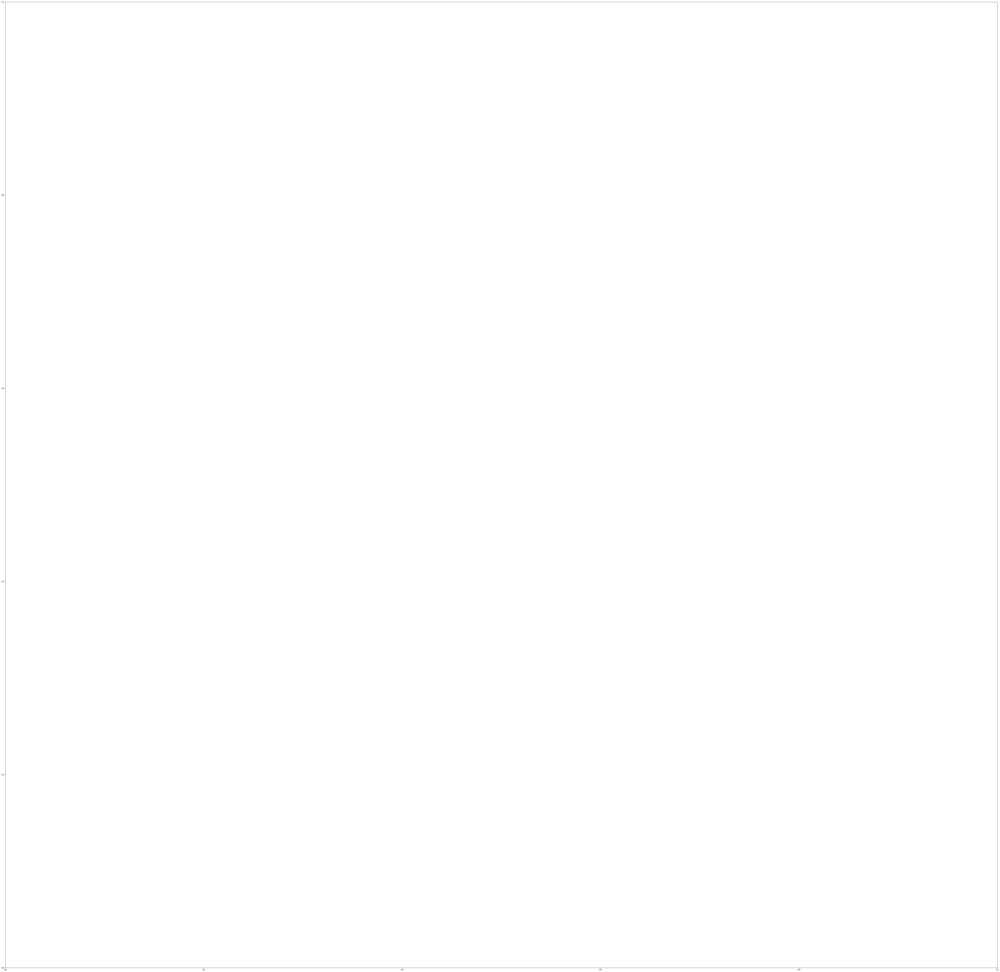

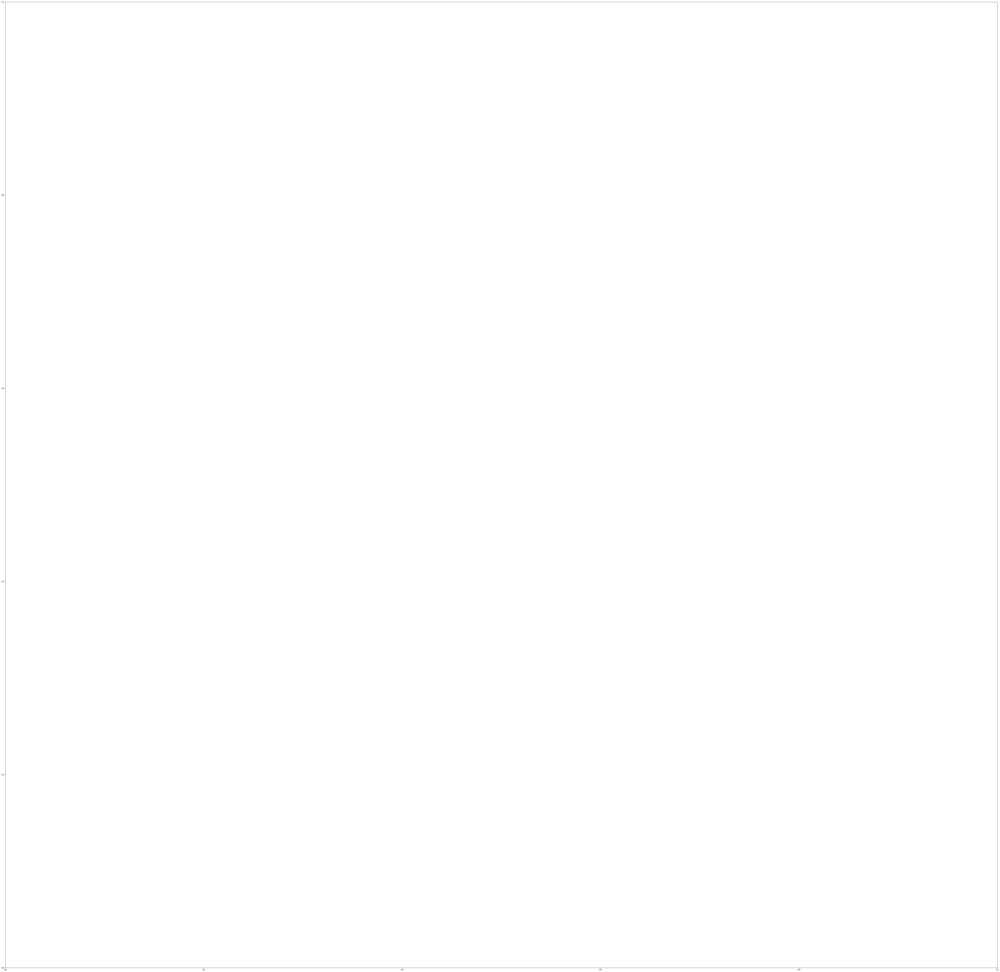

Error in callback <function flush_figures at 0x13722b200> (for post_execute):


KeyboardInterrupt: 

In [5]:
from DRflow.dr.plot import *

for name in names:
    for size in sizes:
        input_folder = '../../data/{}/dr_data/size{}/'.format(name,size)
        output_folder = '../../data/{}/dr_figures/size{}/'.format(name,size)
        thumbnail_folder = '../../data/{}/thumbnails/size{}/'.format(name,size)


        plot_all_dr_files(input_folder, output_folder, thumbnail_folder)   

In [19]:
p = '../../data/'
files = os.listdir(p)
files

for f in files:
    if not os.path.isdir(p+f):
        continue
    
    path = "{}{}/data/".format(p,f)
    try:
        for subfile in os.listdir(path):
            os.rename(path +subfile, path + f +'_' +subfile)
    except:
        continue